# Music Source Separation with U-Net

A comprehensive implementation of music source separation using U-Net architecture with attention mechanisms, following the approach from "Singing Voice Separation with Deep U-Net Convolutional Networks".

## Features
- Enhanced U-Net with attention gates and InstanceNorm
- Complete MUSDB18 dataset processing pipeline
- Training with comprehensive evaluation metrics
- Audio separation and visualization tools
- BSS evaluation metrics (SDR, SIR, SAR)

## Getting Started

### Quick Start
1. **Dataset Setup**: Place your MUSDB18 dataset in an accessible directory
2. **Run Complete Pipeline**: Use `run_complete_pipeline()` for end-to-end training
3. **Separate Audio**: Use `separate_audio()` to separate sources from new audio files
4. **Evaluate**: Use `evaluate_separation_quality()` to assess model performance

### Key Features
- **Enhanced U-Net**: Attention gates + InstanceNorm for better separation
- **Comprehensive Training**: TensorBoard logging, checkpointing, visualization
- **BSS Evaluation**: Industry-standard metrics (SDR, SIR, SAR)
- **End-to-End Pipeline**: From dataset to trained model in one function
- **GPU Support**: Automatic CUDA detection and multi-GPU training

### Requirements
- PyTorch (with CUDA support recommended)
- FFmpeg (for dataset conversion)
- MUSDB18 dataset
- 8GB+ GPU memory recommended for training

**Happy music separation! 🎵**

# 0. Setup, libraries and configuration

In [1]:
# Install required packages (uncomment if needed)
!pip install musdb museval
!pip install numpy==1.24.4
!pip install scikit-learn
!pip install stempeg
# !pip install torch torchvision torchaudio tqdm

# Core imports
import os
import random
import subprocess
import tempfile
import argparse
import glob
import shutil
import json
from typing import List, Tuple, Optional
from collections import OrderedDict
from pathlib import Path
import warnings

# Scientific computing
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.ndimage
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import NMF

# Audio processing
import librosa
import librosa.display
import soundfile as sf
import torchaudio
import musdb
import museval
import stempeg

# Deep learning
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.utils.tensorboard import SummaryWriter

# Progress tracking
from tqdm import tqdm

# Jupyter notebook
from IPython.display import Audio, display

# Suppress warnings
warnings.filterwarnings('ignore')

print("All dependencies loaded successfully!")
print("  Imported packages:")
print("   • Core: os, random, subprocess, tempfile, argparse, glob, shutil, json, pathlib, warnings")
print("   • Scientific: numpy, pandas, matplotlib, seaborn, scipy, sklearn")
print("   • Audio: librosa, soundfile, torchaudio, musdb, museval, stempeg")
print("   • ML: torch + optimizers, sklearn decomposition (NMF)")
print("   • Utils: tqdm, tensorboard, IPython")
print("   • Traditional Methods: NMF, train_test_split, StandardScaler, scipy.ndimage")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 963.0/963.0 kB 15.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 70.9 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gensim 4.3.3 requires scipy<1.14.0,>=1.7.0, but you have scipy 1.15.2 which is incompatible.
mkl-umath 0.1.1 requires numpy<1.27.0,>=1.26.4, but you have numpy 1.24.4 which is incompatible.
mkl-random 1.2.4 requires numpy<1.27.0,>=1.26.4, but you have numpy 1.24.4 which is incompatible.
mkl-fft 1.3.8 requires numpy<1.27.0,>=1.26.4, but you have numpy 1.24.4 which is incompatible.
datasets 3.6.0 requires fsspec[http]<=2025.3.0,>=2023.1.0, but you have fsspec 2025.3.2 which is incompatible.


2025-06-10 20:24:58.794648: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749587099.003135      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749587099.061255      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


All dependencies loaded successfully!
  Imported packages:
   • Core: os, random, subprocess, tempfile, argparse, glob, shutil, json, pathlib, warnings
   • Scientific: numpy, pandas, matplotlib, seaborn, scipy, sklearn
   • Audio: librosa, soundfile, torchaudio, musdb, museval, stempeg
   • ML: torch + optimizers, sklearn decomposition (NMF)
   • Utils: tqdm, tensorboard, IPython
   • Traditional Methods: NMF, train_test_split, StandardScaler, scipy.ndimage


In [29]:
# Global constants
N_FFT = 2047  # FFT size
N_PART = 4  # Number of output parts (drums, bass, other, vocals)
SAMPLING_RATE = 22050  # Sample rate
EPS = 1e-8  # Small epsilon for numerical stability
EPOCHS = 50  # Increased from 10 for better training with early stopping

# Validation and early stopping parameters
DEFAULT_VAL_SPLIT = 0.1  # 15% of training data for validation
DEFAULT_PATIENCE = 50     # Early stopping patience

DEFAULT_LSTM_HIDDEN_SIZE = 512  # BiLSTM hidden units
DEFAULT_LSTM_LAYERS = 3         # Number of BiLSTM layer

print(f"Configuration: N_PART={N_PART}, N_FFT={N_FFT}, SAMPLING_RATE={SAMPLING_RATE}")
print(f"Training: EPOCHS={EPOCHS}, VAL_SPLIT={DEFAULT_VAL_SPLIT}, PATIENCE={DEFAULT_PATIENCE}")

Configuration: N_PART=4, N_FFT=2047, SAMPLING_RATE=22050
Training: EPOCHS=50, VAL_SPLIT=0.1, PATIENCE=50


# Traditional Methods

## 1. Dataset Exploration and Loading

MUSDB18 dataset loaded successfully!
Number of training tracks: 94
Number of test tracks: 50
Exploring track: North To Alaska - All The Same
Duration: 6.8 seconds
Sample rate: 44100 Hz
Number of stems: 5


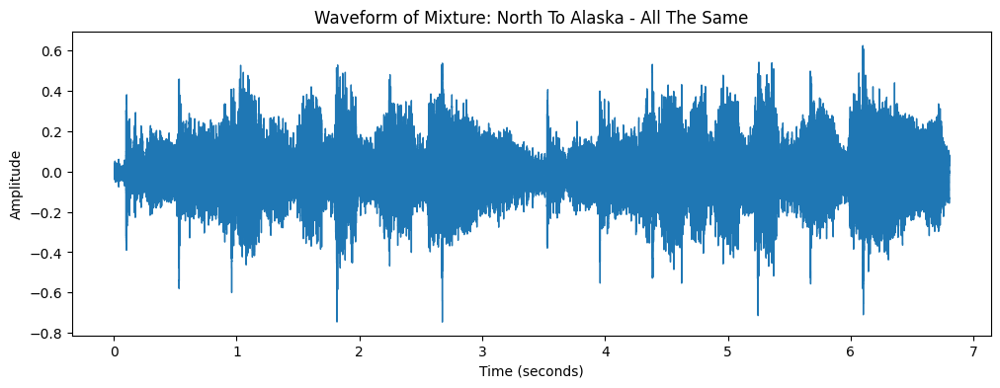

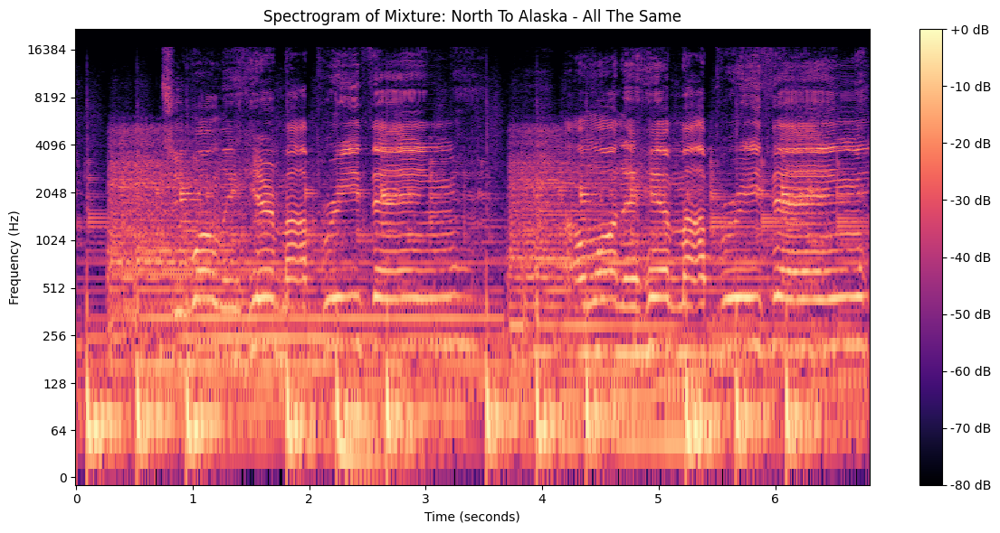

Listening to the mixture of: North To Alaska - All The Same



Exploring Stems:
  Stem: vocals


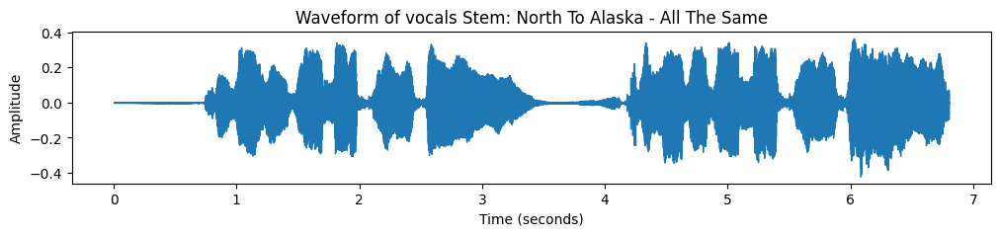

  Listening to the vocals stem:


  Stem: drums


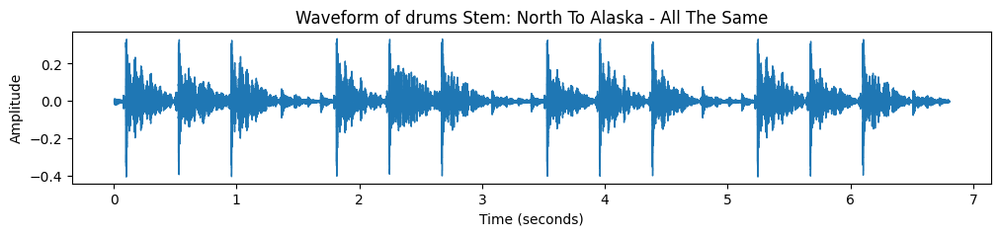

  Listening to the drums stem:


  Stem: bass


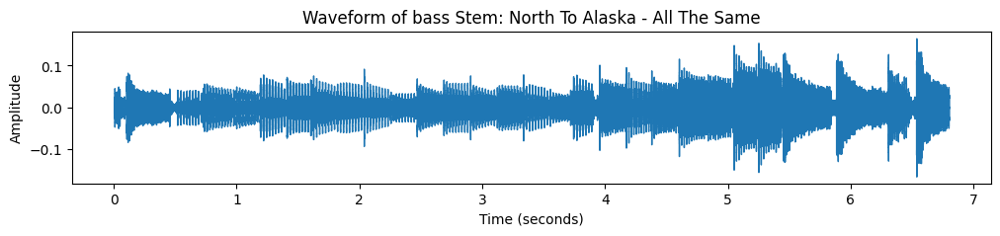

  Listening to the bass stem:


  Stem: other


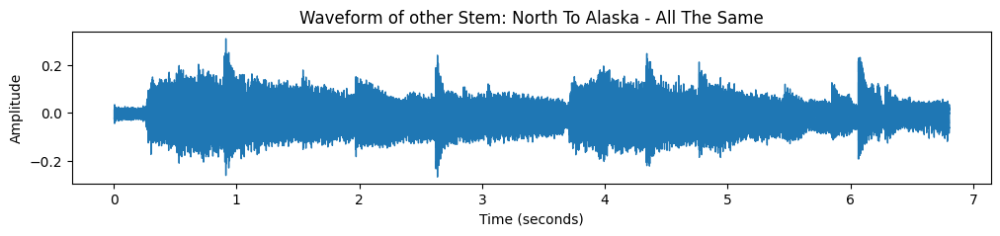

  Listening to the other stem:


In [6]:
mus = musdb.DB(download=True)
class MUSDBDatasetExplorer:
    """Class for exploring the MUSDB18 dataset"""

    def __init__(self, musdb_path=None):
        # Load MUSDB18 dataset
        try:
            self.mus = musdb.DB(root=musdb_path, download=True, subsets=['train', 'test'])
            print(f"MUSDB18 dataset loaded successfully!")
            print(f"Number of training tracks: {len(self.mus.load_mus_tracks(subsets=['train']))}")
            print(f"Number of test tracks: {len(self.mus.load_mus_tracks(subsets=['test']))}")
        except Exception as e:
            print(f"Error loading MUSDB18: {e}")
            print("Please ensure you have proper access to the MUSDB18 dataset")

    def explore_dataset_characteristics(self):
      track = mus.tracks[np.random.randint(len(mus.tracks))]

      print(f"Exploring track: {track.name}")
      print(f"Duration: {track.duration} seconds")
      print(f"Sample rate: {track.rate} Hz")
      print(f"Number of stems: {len(track.stems)}")

      # Visualize the waveform of the mixture
      plt.figure(figsize=(12, 4))
      librosa.display.waveshow(y=track.audio.T, sr=track.rate)
      plt.title(f"Waveform of Mixture: {track.name}")
      plt.xlabel("Time (seconds)")
      plt.ylabel("Amplitude")
      plt.show()

      # Visualize the spectrogram of the mixture
      mixture_stft = librosa.stft(track.audio[:, 0], n_fft=2048, hop_length=512)
      mixture_magnitude, mixture_phase = librosa.magphase(mixture_stft)
      plt.figure(figsize=(12, 6))
      librosa.display.specshow(librosa.amplitude_to_db(mixture_magnitude, ref=np.max),
                              sr=track.rate, hop_length=512, x_axis='time', y_axis='log')
      plt.colorbar(format='%+2.0f dB')
      plt.title(f"Spectrogram of Mixture: {track.name}")
      plt.xlabel("Time (seconds)")
      plt.ylabel("Frequency (Hz)")
      plt.tight_layout()
      plt.show()

      # Listen to the mixture
      print(f"Listening to the mixture of: {track.name}")
      from IPython.display import Audio
      display(Audio(track.audio.T, rate=track.rate))

      # Explore and visualize individual stems
      print("\nExploring Stems:")
      for stem_name in ['vocals', 'drums', 'bass', 'other']:
          stem_audio = track.targets[stem_name].audio

          print(f"  Stem: {stem_name}")

          # Visualize the waveform of the stem
          plt.figure(figsize=(12, 2))
          librosa.display.waveshow(y=stem_audio.T, sr=track.rate)
          plt.title(f"Waveform of {stem_name} Stem: {track.name}")
          plt.xlabel("Time (seconds)")
          plt.ylabel("Amplitude")
          plt.show()

          # Listen to the stem
          print(f"  Listening to the {stem_name} stem:")
          display(Audio(stem_audio.T, rate=track.rate))




# Initialize dataset explorer
explorer = MUSDBDatasetExplorer()
explorer.explore_dataset_characteristics()


## 2. Traditional signal processing approach: Spectral masking


Loaded 94 training tracks
Loaded 50 test tracks

TRADITIONAL SIGNAL PROCESSING APPROACH
Training mask on: A Classic Education - NightOwl
Testing mask on: Actions - One Minute Smile

--- Testing Additional Signal Processing Techniques ---
1. Harmonic-Percussive Separation...
2. NMF Source Separation...
3. Learning masks from training track...
4. Applying learned masks to test track...
Traditional separation completed!


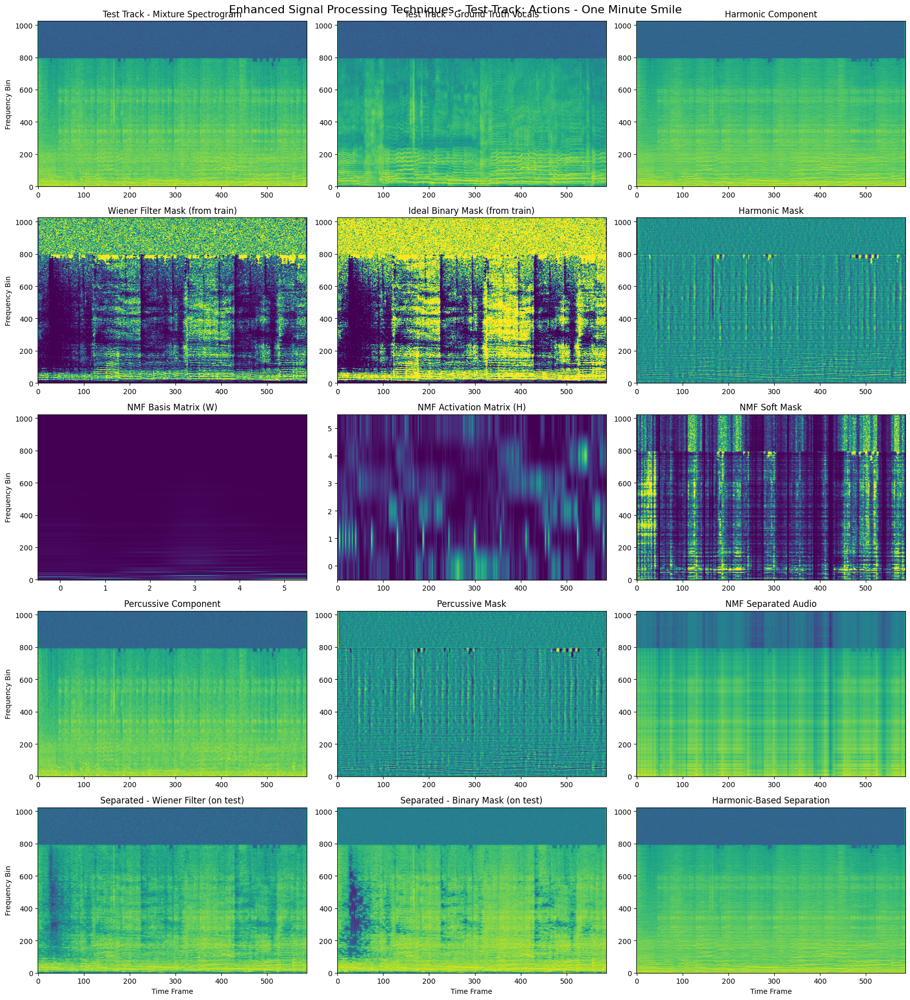

🎧 Train track mixture (A Classic Education - NightOwl):


🎧 Train track ground truth vocals (A Classic Education - NightOwl):


🎧 Vocals separated using Wiener filter mask (applied to test):


🎧 Vocals separated using Binary mask (applied to test):


🎧 Harmonic component (H-P Separation):


🎧 Percussive component (H-P Separation):


🎧 NMF separated vocals:


In [10]:
train_tracks = mus.load_mus_tracks(subsets=['train'])
test_tracks = mus.load_mus_tracks(subsets=['test'])

print(f"Loaded {len(train_tracks)} training tracks")
print(f"Loaded {len(test_tracks)} test tracks")

class SpectralMaskingSeparator:
    """Traditional source separation using spectral masking techniques"""

    def __init__(self, n_fft=2048, hop_length=512, target_stem='vocals'):
        self.n_fft = n_fft
        self.hop_length = hop_length
        self.target_stem = target_stem

    def compute_stft(self, audio, sr):
        """Compute Short-Time Fourier Transform"""
        if len(audio.shape) > 1:
            audio = audio[:, 0]  # Use left channel for mono processing
        return librosa.stft(audio, n_fft=self.n_fft, hop_length=self.hop_length)

    def inverse_stft(self, stft_matrix):
        """Compute inverse STFT"""
        return librosa.istft(stft_matrix, hop_length=self.hop_length)

    def wiener_filter_mask(self, mixture_stft, target_stft, alpha=1.0):
        """Create Wiener filter mask for source separation"""
        # Compute power spectrograms
        mixture_power = np.abs(mixture_stft) ** 2
        target_power = np.abs(target_stft) ** 2

        # Estimate other sources power
        other_power = mixture_power - target_power
        other_power = np.maximum(other_power, 0.01 * mixture_power)  # Avoid division by zero

        # Compute Wiener filter
        wiener_mask = target_power / (target_power + other_power + 1e-10)

        # Apply smoothing
        wiener_mask = wiener_mask ** alpha

        return wiener_mask

    def ideal_binary_mask(self, mixture_stft, target_stft, threshold=0.5):
        """Create Ideal Binary Mask (IBM)"""
        mixture_mag = np.abs(mixture_stft)
        target_mag = np.abs(target_stft)

        # Estimate other sources magnitude
        other_mag = mixture_mag - target_mag
        other_mag = np.maximum(other_mag, 0)

        # Create binary mask
        snr_ratio = target_mag / (other_mag + 1e-10)
        mask = (snr_ratio > threshold).astype(float)

        return mask

    def nmf_source_separation(self, mixture_audio, sr, n_components=6, target_component=1):
        """Separate sources using Non-negative Matrix Factorization"""
        # Compute magnitude spectrogram
        mixture_stft = self.compute_stft(mixture_audio, sr)
        magnitude = np.abs(mixture_stft)
        phase = np.angle(mixture_stft)
        
        # Apply NMF
        nmf = NMF(n_components=n_components, random_state=42, max_iter=200)
        W = nmf.fit_transform(magnitude)
        H = nmf.components_
        
        # Create mask for target component (assuming vocals are in specific components)
        if target_component == 'auto':
            # Automatically select components with higher energy in mid frequencies
            freq_weights = np.linspace(0, 1, W.shape[0])
            component_scores = np.sum(W * freq_weights[:, np.newaxis], axis=0)
            target_components = np.argsort(component_scores)[-2:]  # Top 2 components
        else:
            target_components = [target_component] if isinstance(target_component, int) else target_component
        
        # Reconstruct target source
        target_reconstruction = np.zeros_like(magnitude)
        for comp in target_components:
            target_reconstruction += np.outer(W[:, comp], H[comp, :])
        
        # Create soft mask
        nmf_mask = target_reconstruction / (magnitude + 1e-10)
        nmf_mask = np.clip(nmf_mask, 0, 1)
        
        # Apply mask and reconstruct
        separated_stft = magnitude * nmf_mask * np.exp(1j * phase)
        separated_audio = self.inverse_stft(separated_stft)
        
        return separated_audio, nmf_mask, W, H

    def harmonic_percussive_separation(self, audio, sr):
        """Separate harmonic and percussive components using median filtering"""
        stft = self.compute_stft(audio, sr)
        
        # Convert to magnitude spectrogram
        magnitude = np.abs(stft)
        phase = np.angle(stft)
        
        # Apply median filtering
        harmonic = scipy.ndimage.median_filter(magnitude, size=(1, 17))  # Horizontal filter
        percussive = scipy.ndimage.median_filter(magnitude, size=(17, 1))  # Vertical filter
        
        # Create masks
        harmonic_mask = harmonic / (harmonic + percussive + 1e-10)
        percussive_mask = percussive / (harmonic + percussive + 1e-10)
        
        # Apply masks
        harmonic_stft = magnitude * harmonic_mask * np.exp(1j * phase)
        percussive_stft = magnitude * percussive_mask * np.exp(1j * phase)
        
        # Convert back to time domain
        harmonic_audio = self.inverse_stft(harmonic_stft)
        percussive_audio = self.inverse_stft(percussive_stft)
        
        return harmonic_audio, percussive_audio, harmonic_mask, percussive_mask

    def spectral_subtraction(self, mixture_stft, noise_estimate, alpha=2.0, beta=0.01):
        """Spectral subtraction for noise reduction"""
        mixture_magnitude = np.abs(mixture_stft)
        mixture_phase = np.angle(mixture_stft)
        
        # Estimate clean magnitude
        clean_magnitude = mixture_magnitude - alpha * noise_estimate
        
        # Apply spectral floor
        clean_magnitude = np.maximum(clean_magnitude, beta * mixture_magnitude)
        
        # Reconstruct complex spectrogram
        clean_stft = clean_magnitude * np.exp(1j * mixture_phase)
        
        return clean_stft

    def separate_source(self, mixture_audio, target_audio, sr, method='wiener'):
        """Separate source using spectral masking"""
        # Compute STFTs
        mixture_stft = self.compute_stft(mixture_audio, sr)
        target_stft = self.compute_stft(target_audio, sr)

        # Create mask based on method
        if method == 'wiener':
            mask = self.wiener_filter_mask(mixture_stft, target_stft)
        elif method == 'binary':
            mask = self.ideal_binary_mask(mixture_stft, target_stft)
        else:
            raise ValueError("Method must be 'wiener' or 'binary'")

        # Apply mask
        separated_stft = mixture_stft * mask

        # Convert back to time domain
        separated_audio = self.inverse_stft(separated_stft)

        return separated_audio, mask

    def apply_mask(self, mixture_audio, mask, sr):
        """Apply a pre-computed mask to separate audio"""
        mixture_stft = self.compute_stft(mixture_audio, sr)
        separated_stft = mixture_stft * mask
        separated_audio = self.inverse_stft(separated_stft)
        return separated_audio

# Test traditional approach with additional techniques
print("\n" + "="*50)
print("TRADITIONAL SIGNAL PROCESSING APPROACH")
print("="*50)

# Initialize separator
traditional_separator = SpectralMaskingSeparator(target_stem='vocals')

# Use different tracks for training mask and testing
train_track = train_tracks[0]  # First track for creating the mask
test_track = train_tracks[5]   # Different track for testing the mask

print(f"Training mask on: {train_track.name}")
print(f"Testing mask on: {test_track.name}")

# Get 10-second segment for both tracks
segment_length = 10 * train_track.rate
train_mixture_segment = train_track.audio[:segment_length]
train_vocals_segment = train_track.targets['vocals'].audio[:segment_length]

test_mixture_segment = test_track.audio[:segment_length]
test_vocals_segment = test_track.targets['vocals'].audio[:segment_length]

# Test additional signal processing techniques
print("\n--- Testing Additional Signal Processing Techniques ---")

# 1. Harmonic-Percussive Separation
print("1. Harmonic-Percussive Separation...")
import scipy.ndimage
harmonic, percussive, harm_mask, perc_mask = traditional_separator.harmonic_percussive_separation(
    test_mixture_segment, test_track.rate
)

# 2. NMF Source Separation
print("2. NMF Source Separation...")
nmf_separated, nmf_mask, W_nmf, H_nmf = traditional_separator.nmf_source_separation(
    test_mixture_segment, test_track.rate, n_components=6, target_component=[1, 2]
)

# Learn masks from training track
print("3. Learning masks from training track...")
_, wiener_mask = traditional_separator.separate_source(
    train_mixture_segment, train_vocals_segment, train_track.rate, method='wiener'
)

_, binary_mask = traditional_separator.separate_source(
    train_mixture_segment, train_vocals_segment, train_track.rate, method='binary'
)

# Apply the learned masks to the test track
print("4. Applying learned masks to test track...")
vocals_wiener_test = traditional_separator.apply_mask(
    test_mixture_segment, wiener_mask, test_track.rate
)

vocals_binary_test = traditional_separator.apply_mask(
    test_mixture_segment, binary_mask, test_track.rate
)

print("Traditional separation completed!")

# Enhanced Visualization with NMF
fig, axes = plt.subplots(5, 3, figsize=(18, 20))
fig.suptitle(f'Enhanced Signal Processing Techniques - Test Track: {test_track.name}', fontsize=16)
# Row 1: Original and Ground Truth
test_mixture_stft = traditional_separator.compute_stft(test_mixture_segment[:, 0], test_track.rate)
test_vocals_stft = traditional_separator.compute_stft(test_vocals_segment[:, 0], test_track.rate)

axes[0, 0].imshow(np.log(np.abs(test_mixture_stft) + 1e-10), aspect='auto', origin='lower')
axes[0, 0].set_title('Test Track - Mixture Spectrogram')
axes[0, 0].set_ylabel('Frequency Bin')

axes[0, 1].imshow(np.log(np.abs(test_vocals_stft) + 1e-10), aspect='auto', origin='lower')
axes[0, 1].set_title('Test Track - Ground Truth Vocals')

# Show harmonic component
harmonic_stft = traditional_separator.compute_stft(harmonic, test_track.rate)
axes[0, 2].imshow(np.log(np.abs(harmonic_stft) + 1e-10), aspect='auto', origin='lower')
axes[0, 2].set_title('Harmonic Component')

# Row 2: Traditional Masks (learned from training track)
axes[1, 0].imshow(wiener_mask, aspect='auto', origin='lower', cmap='viridis')
axes[1, 0].set_title('Wiener Filter Mask (from train)')
axes[1, 0].set_ylabel('Frequency Bin')

axes[1, 1].imshow(binary_mask, aspect='auto', origin='lower', cmap='viridis')
axes[1, 1].set_title('Ideal Binary Mask (from train)')

axes[1, 2].imshow(harm_mask, aspect='auto', origin='lower', cmap='viridis')
axes[1, 2].set_title('Harmonic Mask')

# Row 3: NMF Analysis
axes[2, 0].imshow(W_nmf, aspect='auto', origin='lower', cmap='viridis')
axes[2, 0].set_title('NMF Basis Matrix (W)')
axes[2, 0].set_ylabel('Frequency Bin')

axes[2, 1].imshow(H_nmf, aspect='auto', origin='lower', cmap='viridis')
axes[2, 1].set_title('NMF Activation Matrix (H)')

axes[2, 2].imshow(nmf_mask, aspect='auto', origin='lower', cmap='viridis')
axes[2, 2].set_title('NMF Soft Mask')

# Row 4: Additional Components
percussive_stft = traditional_separator.compute_stft(percussive, test_track.rate)
axes[3, 0].imshow(np.log(np.abs(percussive_stft) + 1e-10), aspect='auto', origin='lower')
axes[3, 0].set_title('Percussive Component')
axes[3, 0].set_ylabel('Frequency Bin')

axes[3, 1].imshow(perc_mask, aspect='auto', origin='lower', cmap='viridis')
axes[3, 1].set_title('Percussive Mask')

# Show NMF separated result
nmf_stft = traditional_separator.compute_stft(nmf_separated, test_track.rate)
axes[3, 2].imshow(np.log(np.abs(nmf_stft) + 1e-10), aspect='auto', origin='lower')
axes[3, 2].set_title('NMF Separated Audio')

# Row 5: Separated Results Comparison
vocals_wiener_stft = traditional_separator.compute_stft(vocals_wiener_test, test_track.rate)
vocals_binary_stft = traditional_separator.compute_stft(vocals_binary_test, test_track.rate)

axes[4, 0].imshow(np.log(np.abs(vocals_wiener_stft) + 1e-10), aspect='auto', origin='lower')
axes[4, 0].set_title('Separated - Wiener Filter (on test)')
axes[4, 0].set_xlabel('Time Frame')
axes[4, 0].set_ylabel('Frequency Bin')

axes[4, 1].imshow(np.log(np.abs(vocals_binary_stft) + 1e-10), aspect='auto', origin='lower')
axes[4, 1].set_title('Separated - Binary Mask (on test)')
axes[4, 1].set_xlabel('Time Frame')

axes[4, 2].imshow(np.log(np.abs(harmonic_stft) + 1e-10), aspect='auto', origin='lower')
axes[4, 2].set_title('Harmonic-Based Separation')
axes[4, 2].set_xlabel('Time Frame')

plt.tight_layout()
plt.show()

# Audio playback for comparison
print(f" Train track mixture ({train_track.name}):")
display(Audio(train_mixture_segment.T, rate=train_track.rate))

print(f" Train track ground truth vocals ({train_track.name}):")
display(Audio(train_vocals_segment.T, rate=train_track.rate))

print(" Vocals separated using Wiener filter mask (applied to test):")
display(Audio(vocals_wiener_test, rate=test_track.rate))

print(" Vocals separated using Binary mask (applied to test):")
display(Audio(vocals_binary_test, rate=test_track.rate))

print(" Harmonic component (H-P Separation):")
display(Audio(harmonic, rate=test_track.rate))

print(" Percussive component (H-P Separation):")
display(Audio(percussive, rate=test_track.rate))

print(" NMF separated vocals:")
display(Audio(nmf_separated, rate=test_track.rate))


# Music Source Separation with enhanced Unet Architectures

MUSDB18 dataset loaded successfully!
Training tracks: 94
Test tracks: 50
Exploring track: Triviul - Dorothy
Duration: 6.80 seconds
Sample rate: 44100 Hz
Number of stems: 5


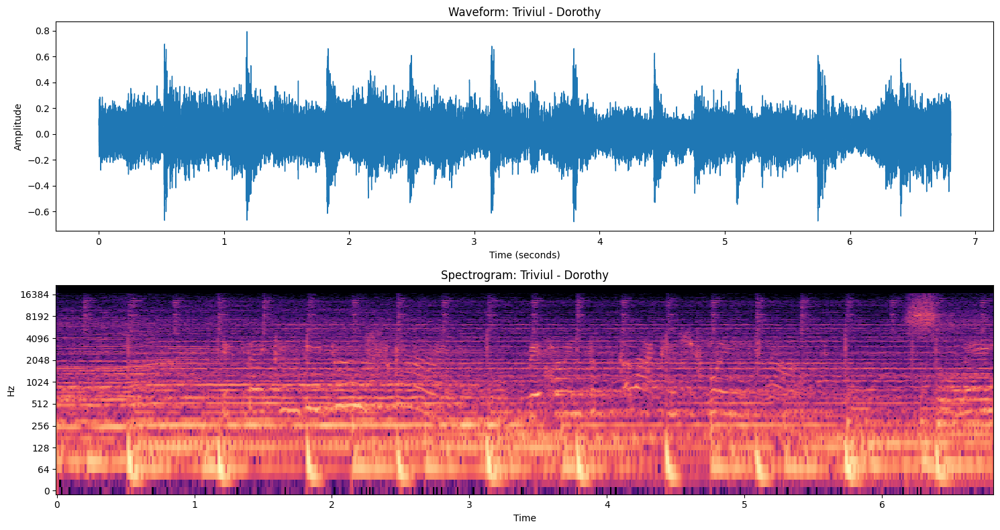

Playing mixture:



Playing vocals:



Playing drums:



Playing bass:



Playing other:


In [11]:
class MUSDBDatasetExplorer:
    """Class for exploring the MUSDB18 dataset"""

    def __init__(self, musdb_path=None):
        try:
            self.mus = musdb.DB(root=musdb_path, download=True, subsets=['train', 'test'])
            print(f"MUSDB18 dataset loaded successfully!")
            print(f"Training tracks: {len(self.mus.load_mus_tracks(subsets=['train']))}")
            print(f"Test tracks: {len(self.mus.load_mus_tracks(subsets=['test']))}")
        except Exception as e:
            print(f"Error loading MUSDB18: {e}")
            self.mus = None

    def explore_dataset_characteristics(self, track_idx=None):
        """Explore dataset characteristics with visualization"""
        if self.mus is None:
            print("Dataset not loaded. Cannot explore.")
            return

        # Select track
        if track_idx is None:
            track_idx = np.random.randint(len(self.mus.tracks))
        track = self.mus.tracks[track_idx]

        print(f"Exploring track: {track.name}")
        print(f"Duration: {track.duration:.2f} seconds")
        print(f"Sample rate: {track.rate} Hz")
        print(f"Number of stems: {len(track.stems)}")

        # Visualize mixture waveform and spectrogram
        fig, axes = plt.subplots(2, 1, figsize=(15, 8))

        # Waveform
        librosa.display.waveshow(y=track.audio.T, sr=track.rate, ax=axes[0])
        axes[0].set_title(f"Waveform: {track.name}")
        axes[0].set_xlabel("Time (seconds)")
        axes[0].set_ylabel("Amplitude")

        # Spectrogram
        mixture_stft = librosa.stft(track.audio[:, 0], n_fft=2048, hop_length=512)
        mixture_magnitude = np.abs(mixture_stft)
        librosa.display.specshow(
            librosa.amplitude_to_db(mixture_magnitude, ref=np.max),
            sr=track.rate, hop_length=512, x_axis='time', y_axis='log', ax=axes[1]
        )
        axes[1].set_title(f"Spectrogram: {track.name}")

        plt.tight_layout()
        plt.show()

        # Audio playback
        print("Playing mixture:")
        display(Audio(track.audio.T, rate=track.rate))

        # Explore individual stems
        stem_names = ['vocals', 'drums', 'bass', 'other']
        for stem_name in stem_names:
            stem_audio = track.targets[stem_name].audio
            print(f"\nPlaying {stem_name}:")
            display(Audio(stem_audio.T, rate=track.rate))

# Initialize explorer
explorer = MUSDBDatasetExplorer()
if explorer.mus:
    explorer.explore_dataset_characteristics()

## 1. Dataset Conversion and Processing

In [12]:
def convert_musdb18_to_wav(origin_dataset_dir: str, new_dataset_dir: str, sr: int = 22050):
    """Convert MUSDB18 dataset to .wav format with 5 channels:
    0: mixture, 1: drums, 2: bass, 3: other, 4: vocals"""

    if os.path.isdir(new_dataset_dir):
        raise FileExistsError(f'{new_dataset_dir} already exists.')

    os.makedirs(new_dataset_dir)
    os.makedirs(os.path.join(new_dataset_dir, 'train'))
    os.makedirs(os.path.join(new_dataset_dir, 'test'))

    with tempfile.TemporaryDirectory() as tmpdir:
        for subdir in ('train', 'test'):
            origin_dir = os.path.join(origin_dataset_dir, subdir)
            files = [f for f in os.listdir(origin_dir) if f.endswith('.mp4')]

            for file in files:
                path = os.path.join(origin_dir, file)
                name = os.path.splitext(file)[0]
                wav_data = []

                # Extract each channel
                for ch in range(5):
                    temp_fn = f'{name}.{ch}.wav'
                    out_path = os.path.join(tmpdir, temp_fn)
                    subprocess.run(['ffmpeg', '-i', path, '-map', f'0:{ch}', out_path],
                                 capture_output=True)
                    sound, _ = librosa.load(out_path, sr=sr, mono=True)
                    wav_data.append(sound)

                wav_data = np.stack(wav_data, axis=1)
                out_path = os.path.join(new_dataset_dir, subdir, f'{name}.wav')
                sf.write(out_path, wav_data, sr)

    print(f"Dataset conversion completed: {new_dataset_dir}")

def verify_dataset_structure(dataset_path: str) -> dict:
    """Verify dataset structure and return status"""
    results = {
        'dataset_exists': os.path.exists(dataset_path),
        'train_dir_exists': os.path.exists(os.path.join(dataset_path, 'train')),
        'test_dir_exists': os.path.exists(os.path.join(dataset_path, 'test')),
        'train_files_count': 0,
        'test_files_count': 0
    }

    if results['train_dir_exists']:
        results['train_files_count'] = len(glob.glob(os.path.join(dataset_path, 'train', '*.wav')))
    if results['test_dir_exists']:
        results['test_files_count'] = len(glob.glob(os.path.join(dataset_path, 'test', '*.wav')))

    results['is_valid'] = all([
        results['dataset_exists'],
        results['train_dir_exists'],
        results['test_dir_exists'],
        results['train_files_count'] > 0,
        results['test_files_count'] > 0
    ])

    print(f"Dataset verification: {dataset_path}")
    print(f"  Valid: {results['is_valid']}")
    print(f"  Train files: {results['train_files_count']}")
    print(f"  Test files: {results['test_files_count']}")

    return results

print("Dataset conversion functions defined!")

Dataset conversion functions defined!


In [13]:
def read_data(dataset_dir: str, n_fft: int, data_len: int, sampling_rate: int, val_split: float = 0.15):
    """Load and preprocess MUSDB18 dataset for training with validation split"""
    window = torch.hann_window(n_fft)

    with torch.no_grad():
        # Load training data
        train_dir = os.path.join(dataset_dir, 'train')
        wav_files = glob.glob(os.path.join(train_dir, '*.wav'))

        train = []
        for path in wav_files:
            try:
                sound, sr = torchaudio.load(path)
                assert sr == sampling_rate, f"Sample rate mismatch: {path}"

                if sound.shape[0] < 5:
                    print(f"Skipping {path}: insufficient channels ({sound.shape[0]})")
                    continue

                # Extract mixture and sources
                mix_audio = sound[0:1, :]
                source_audio = sound[1:5, :]

                # Compute spectrograms
                mix_spec = torch.stft(mix_audio, n_fft, window=window, return_complex=True).abs()
                source_spec = torch.stft(source_audio, n_fft, window=window, return_complex=True).abs()

                x = mix_spec.squeeze(0)  # [freq, time]
                t = source_spec  # [4, freq, time]

                # Split into segments
                hop = data_len // 4
                num_segments = (x.size(1) - data_len) // hop + 1

                if num_segments <= 0:
                    # Pad short tracks
                    pad_amount = data_len - x.size(1)
                    x_padded = F.pad(x, (0, pad_amount))
                    t_padded = F.pad(t, (0, pad_amount))
                    train.append((x_padded, t_padded))
                else:
                    for n in range(num_segments):
                        start = n * hop
                        train.append((x[:, start:start + data_len],
                                    t[:, :, start:start + data_len]))

            except Exception as e:
                print(f"Error processing {path}: {e}")
                continue

        # Split train data into train and validation
        random.shuffle(train)
        val_size = int(len(train) * val_split)
        val_data = train[:val_size]
        train_data = train[val_size:]

        # Load test data
        test_dir = os.path.join(dataset_dir, 'test')
        wav_files = glob.glob(os.path.join(test_dir, '*.wav'))

        test = []
        for path in wav_files:
            try:
                sound, sr = torchaudio.load(path)
                assert sr == sampling_rate

                if sound.shape[0] < 5:
                    continue

                sound = sound[:5, :]
                # Split for memory efficiency
                split_sound = torch.split(sound, sound.size(1) // 2, dim=1)
                test.extend(split_sound)

            except Exception as e:
                print(f"Error processing test {path}: {e}")
                continue

    print(f"Data loaded: {len(train_data)} train segments, {len(val_data)} validation segments, {len(test)} test segments")
    return train_data, val_data, test

# RandomCropDataset class
class RandomCropDataset(torch.utils.data.Dataset):
    """Dataset for random cropping of spectrograms with dimension consistency"""

    def __init__(self, data: List[Tuple[torch.Tensor, torch.Tensor]], out_len: int):
        self.data = data
        self.len = out_len
        self.len = ((out_len + 63) // 64) * 64

    def __len__(self):
        return len(self.data)

    def __getitem__(self, item):
        x, t = self.data[item]
        length = x.size(1)

        if length < self.len:
            pad_amount = self.len - length
            x = F.pad(x, (0, pad_amount))
            t = F.pad(t, (0, pad_amount))
            i = 0
        else:
            i = random.randint(0, length - self.len)

        x_crop = x[:, i:i + self.len]
        t_crop = t[:, :, i:i + self.len]

        # Ensure dimensions are power-of-2 compatible
        x_crop = ensure_power_of_2_dimensions(x_crop)
        t_crop = ensure_power_of_2_dimensions(t_crop)

        return x_crop, t_crop

print("Data loading functions with validation split defined")

Data loading functions with validation split defined


## 2. Model Architecture

In [30]:
def padding(sound_stft: torch.Tensor) -> Tuple[torch.Tensor, Tuple[int, int]]:
    """Apply reflection padding to ensure frames are multiple of 64"""
    n_frames = sound_stft.size(-1)
    n_pad = (64 - n_frames % 64) % 64

    if n_pad:
        left = n_pad // 2
        right = n_pad - left
        return F.pad(sound_stft, (left, right), mode='reflect'), (left, right)
    else:
        return sound_stft, (0, 0)

def ensure_power_of_2_dimensions(x: torch.Tensor, min_size: int = 64) -> torch.Tensor:
    """Ensure tensor dimensions are compatible with U-Net downsampling (powers of 2)"""
    freq_bins, time_frames = x.shape[-2], x.shape[-1]

    # Find next power of 2 that's >= min_size
    def next_power_of_2(n):
        return max(min_size, 2 ** int(np.ceil(np.log2(n))))

    target_freq = next_power_of_2(freq_bins)
    target_time = next_power_of_2(time_frames)

    # Pad to target dimensions
    freq_pad = target_freq - freq_bins
    time_pad = target_time - time_frames

    if freq_pad > 0 or time_pad > 0:
        padding = (0, time_pad, 0, freq_pad)  # (left, right, top, bottom)
        x = F.pad(x, padding, mode='reflect')

    return x

class AttentionBlock(nn.Module):
    """Attention block for U-Net skip connections"""

    def __init__(self, gate_channels, inter_channels):
        super(AttentionBlock, self).__init__()
        self.gate_conv = nn.Conv2d(gate_channels, inter_channels, 1, bias=True)
        self.skip_conv = nn.Conv2d(inter_channels, inter_channels, 1, bias=True)
        self.psi = nn.Conv2d(inter_channels, 1, 1, bias=True)
        self.relu = nn.ReLU(inplace=True)
        self.sigmoid = nn.Sigmoid()

    def forward(self, gate, skip):
        g1 = self.gate_conv(gate)
        x1 = self.skip_conv(skip)
        psi = self.relu(g1 + x1)
        psi = self.sigmoid(self.psi(psi))
        return skip * psi

class BiLSTMBottleneck(nn.Module):
    """BiLSTM module for the bottleneck of U-Net"""

    def __init__(self, input_channels, hidden_size=256, num_layers=2, dropout=0.3):
        super(BiLSTMBottleneck, self).__init__()
        self.input_channels = input_channels
        self.hidden_size = hidden_size
        self.num_layers = num_layers

        # BiLSTM layers - process each frequency bin independently
        self.bilstm = nn.LSTM(
            input_size=input_channels,  # Process channels at each frequency bin
            hidden_size=hidden_size,
            num_layers=num_layers,
            batch_first=True,
            bidirectional=True,
            dropout=dropout if num_layers > 1 else 0
        )

        # Output projection to match input channels
        self.output_proj = nn.Linear(hidden_size * 2, input_channels)
        self.dropout = nn.Dropout(dropout)

    def forward(self, x):
        # x shape: [batch, channels, freq, time]
        batch_size, channels, freq_bins, time_steps = x.shape

        # Process each frequency bin independently
        # Reshape to [batch*freq, time, channels]
        x_reshaped = x.permute(0, 2, 3, 1).contiguous()  # [batch, freq, time, channels]
        x_reshaped = x_reshaped.view(batch_size * freq_bins, time_steps, channels)

        # Apply BiLSTM
        lstm_out, _ = self.bilstm(x_reshaped)  # [batch*freq, time, hidden_size*2]
        lstm_out = self.dropout(lstm_out)

        # Project back to original feature dimension
        output = self.output_proj(lstm_out)  # [batch*freq, time, channels]

        # Reshape back to original format
        output = output.view(batch_size, freq_bins, time_steps, channels)
        output = output.permute(0, 3, 1, 2).contiguous()  # [batch, channels, freq, time]

        # Residual connection
        return output + x

class UNet(nn.Module):
    """Enhanced U-Net with attention gates, InstanceNorm, and BiLSTM bottleneck"""

    def __init__(self, n_class: int, lstm_hidden_size: int = 256, lstm_layers: int = 2):
        super(UNet, self).__init__()

        # Encoder
        self.conv1 = nn.Conv2d(1, 16, 5, 2, 2)
        self.conv_in1 = nn.InstanceNorm2d(16)
        self.conv2 = nn.Conv2d(16, 32, 5, 2, 2)
        self.conv_in2 = nn.InstanceNorm2d(32)
        self.conv3 = nn.Conv2d(32, 64, 5, 2, 2)
        self.conv_in3 = nn.InstanceNorm2d(64)
        self.conv4 = nn.Conv2d(64, 128, 5, 2, 2)
        self.conv_in4 = nn.InstanceNorm2d(128)
        self.conv5 = nn.Conv2d(128, 256, 5, 2, 2)
        self.conv_in5 = nn.InstanceNorm2d(256)
        self.conv6 = nn.Conv2d(256, 512, 5, 2, 2)
        self.conv_in6 = nn.InstanceNorm2d(512)

        # BiLSTM bottleneck
        self.bilstm_bottleneck = BiLSTMBottleneck(
            input_channels=512,
            hidden_size=lstm_hidden_size,
            num_layers=lstm_layers
        )

        # Attention gates
        self.att1 = AttentionBlock(256, 256)
        self.att2 = AttentionBlock(128, 128)
        self.att3 = AttentionBlock(64, 64)
        self.att4 = AttentionBlock(32, 32)
        self.att5 = AttentionBlock(16, 16)

        # Decoder
        self.deconv1 = nn.ConvTranspose2d(512, 256, 5, 2, 2, 1)
        self.deconv_in1 = nn.InstanceNorm2d(256)
        self.dropout1 = nn.Dropout2d(0.5)

        self.deconv2 = nn.ConvTranspose2d(512, 128, 5, 2, 2, 1)
        self.deconv_in2 = nn.InstanceNorm2d(128)
        self.dropout2 = nn.Dropout2d(0.5)

        self.deconv3 = nn.ConvTranspose2d(256, 64, 5, 2, 2, 1)
        self.deconv_in3 = nn.InstanceNorm2d(64)
        self.dropout3 = nn.Dropout2d(0.5)

        self.deconv4 = nn.ConvTranspose2d(128, 32, 5, 2, 2, 1)
        self.deconv_in4 = nn.InstanceNorm2d(32)

        self.deconv5 = nn.ConvTranspose2d(64, 16, 5, 2, 2, 1)
        self.deconv_in5 = nn.InstanceNorm2d(16)

        self.deconv6 = nn.ConvTranspose2d(32, n_class, 5, 2, 2, 1)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # Add channel dimension and log transform
        x = x.unsqueeze(1)
        x = torch.log(x + EPS)

        # Encoder with size tracking for debugging
        h1 = F.leaky_relu(self.conv_in1(self.conv1(x)), 0.2)
        h2 = F.leaky_relu(self.conv_in2(self.conv2(h1)), 0.2)
        h3 = F.leaky_relu(self.conv_in3(self.conv3(h2)), 0.2)
        h4 = F.leaky_relu(self.conv_in4(self.conv4(h3)), 0.2)
        h5 = F.leaky_relu(self.conv_in5(self.conv5(h4)), 0.2)
        h = F.leaky_relu(self.conv_in6(self.conv6(h5)), 0.2)

        # BiLSTM bottleneck
        h = self.bilstm_bottleneck(h)

        # Decoder with attention and size matching
        h = self.dropout1(F.relu(self.deconv_in1(self.deconv1(h))))

        # Ensure h and h5 have matching spatial dimensions
        if h.shape[2:] != h5.shape[2:]:
            h = F.interpolate(h, size=h5.shape[2:], mode='bilinear', align_corners=False)
        h5_att = self.att1(h, h5)
        h = torch.cat((h, h5_att), dim=1)

        h = self.dropout2(F.relu(self.deconv_in2(self.deconv2(h))))
        if h.shape[2:] != h4.shape[2:]:
            h = F.interpolate(h, size=h4.shape[2:], mode='bilinear', align_corners=False)
        h4_att = self.att2(h, h4)
        h = torch.cat((h, h4_att), dim=1)

        h = self.dropout3(F.relu(self.deconv_in3(self.deconv3(h))))
        if h.shape[2:] != h3.shape[2:]:
            h = F.interpolate(h, size=h3.shape[2:], mode='bilinear', align_corners=False)
        h3_att = self.att3(h, h3)
        h = torch.cat((h, h3_att), dim=1)

        h = F.relu(self.deconv_in4(self.deconv4(h)))
        if h.shape[2:] != h2.shape[2:]:
            h = F.interpolate(h, size=h2.shape[2:], mode='bilinear', align_corners=False)
        h2_att = self.att4(h, h2)
        h = torch.cat((h, h2_att), dim=1)

        h = F.relu(self.deconv_in5(self.deconv5(h)))
        if h.shape[2:] != h1.shape[2:]:
            h = F.interpolate(h, size=h1.shape[2:], mode='bilinear', align_corners=False)
        h1_att = self.att5(h, h1)
        h = torch.cat((h, h1_att), dim=1)

        h = F.softmax(self.deconv6(h), dim=1)

        # Ensure output matches input spatial dimensions
        if h.shape[2:] != x.shape[2:]:
            h = F.interpolate(h, size=x.shape[2:], mode='bilinear', align_corners=False)

        return h

# Test model with BiLSTM
sample_model = UNet(N_PART, lstm_hidden_size=256, lstm_layers=2)
total_params = sum(p.numel() for p in sample_model.parameters())
trainable_params = sum(p.numel() for p in sample_model.parameters() if p.requires_grad)

print(f"Enhanced U-Net model with BiLSTM bottleneck defined")
print(f"Total parameters: {total_params:,}")
print(f"Trainable parameters: {trainable_params:,}")
print(f"BiLSTM bottleneck added")

Enhanced U-Net model with BiLSTM bottleneck defined
Total parameters: 13,415,369
Trainable parameters: 13,415,369
BiLSTM bottleneck added


## 3. Training Pipeline

In [64]:
def compute_separation_loss(y_pred, y_true, loss_type='multi_scale_l1'):
    """Simple multi-scale L1 loss for better separation quality"""

    if loss_type == 'multi_scale_l1':
        # Multi-scale L1 loss
        total_loss = 0
        scales = [1, 2, 4]  # Original, 2x downsampled, 4x downsampled

        for scale in scales:
            if scale > 1:
                # Simple average pooling for downsampling
                pred_scaled = F.avg_pool2d(y_pred, kernel_size=scale, stride=scale)
                true_scaled = F.avg_pool2d(y_true, kernel_size=scale, stride=scale)
            else:
                pred_scaled, true_scaled = y_pred, y_true

            total_loss += F.l1_loss(pred_scaled, true_scaled)

        return total_loss / len(scales)  # Average across scales

    else:

        return F.l1_loss(y_pred, y_true, reduction='mean')

print("Multi-scale L1 loss function added")


def train_epoch(model, data_loader, optimizer, device, epoch, tb_writer):
    """Train model for one epoch with improved loss calculation"""
    model.train()
    total_loss = 0

    for x, t in data_loader:
        batch_size = x.size(0)
        x, t = x.to(device), t.to(device)
        y = model(x) * x.unsqueeze(1)

        #loss = F.l1_loss(y, t, reduction='mean')
        loss = compute_separation_loss(y, t, loss_type='multi_scale_l1')
        total_loss += loss.item()

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    avg_loss = total_loss / len(data_loader)
    tb_writer.add_scalar('train/loss', avg_loss, epoch)
    return avg_loss

def validate_epoch(model, val_loader, device, epoch, tb_writer):
    """Validate model for one epoch using batched data"""
    model.eval()
    total_loss = 0

    with torch.no_grad():
        for x, t in val_loader:
            batch_size = x.size(0)
            x, t = x.to(device), t.to(device)
            y = model(x) * x.unsqueeze(1)
            #loss = F.l1_loss(y, t, reduction='mean')
            loss = compute_separation_loss(y, t, loss_type='multi_scale_l1')
            total_loss += loss.item()

    avg_loss = total_loss / len(val_loader)
    tb_writer.add_scalar('validation/loss', avg_loss, epoch)
    return avg_loss

def test_epoch(model, test_data, device, epoch, tb_writer):
    """Evaluate model on test data with improved loss calculation"""
    model.eval()
    total_loss = 0
    num_samples = 0

    with torch.no_grad():
        window = torch.hann_window(N_FFT, device=device)

        for sound in test_data:
            sound = sound.to(device)
            mix_audio = sound[[0], :]
            sources_audio = sound[1:, :]

            # Compute spectrograms
            mix_stft = torch.stft(mix_audio, N_FFT, window=window, return_complex=True)
            mix_spec = mix_stft.abs().squeeze(0)

            sources_stft = torch.stft(sources_audio, N_FFT, window=window, return_complex=True)
            sources_spec = sources_stft.abs()

            # Pad and get mask
            x_padded, (left, right) = padding(mix_spec)
            mask = model(x_padded.unsqueeze(0)).squeeze(0)

            # Remove padding
            right_mask = x_padded.size(1) - right if right > 0 else x_padded.size(1)
            mask = mask[:, :, left:right_mask]

            # Apply mask and compute loss
            if mask.size(-1) != mix_spec.size(-1):
                mask = F.interpolate(mask.unsqueeze(0), size=(mask.size(-2), mix_spec.size(-1)),
                                   mode='nearest-exact').squeeze(0)

            y = mask * mix_spec.unsqueeze(0)
            #loss = F.l1_loss(y, sources_spec, reduction='mean')
            loss = compute_separation_loss(y.unsqueeze(0), sources_spec.unsqueeze(0), loss_type='multi_scale_l1')
            total_loss += loss.item()
            num_samples += 1

    avg_loss = total_loss / num_samples
    tb_writer.add_scalar('test/loss', avg_loss, epoch)
    return avg_loss

def train_model(dataset_path: str,
                batch_size: int = 32,
                epochs: int = 100,
                eval_interval: int = 10,
                learning_rate: float = 1e-3,
                output_dir: str = './models',
                gpu_ids: List[int] = [0],
                use_cuda: bool = True,
                data_len_read_data: int = 512,
                data_len_random_crop: int = 256,
                lstm_hidden_size: int = 256,
                lstm_layers: int = 2,
                val_split: float = DEFAULT_VAL_SPLIT,
                patience: int = DEFAULT_PATIENCE):
    """Main training function with BiLSTM support, validation, and early stopping"""

    # Setup
    os.makedirs(output_dir, exist_ok=True)
    if_use_cuda = torch.cuda.is_available() and use_cuda
    device = torch.device(f'cuda:{gpu_ids[0]}' if if_use_cuda else 'cpu')
    print(f"Using device: {device}")

    # Model with BiLSTM
    model = UNet(N_PART, lstm_hidden_size=lstm_hidden_size, lstm_layers=lstm_layers)
    if if_use_cuda and len(gpu_ids) > 1:
        model = nn.DataParallel(model, device_ids=gpu_ids)
    model = model.to(device)

    # Print model info
    total_params = sum(p.numel() for p in model.parameters())
    print(f"Model with BiLSTM bottleneck - Total parameters: {total_params:,}")
    print(f"BiLSTM config: hidden_size={lstm_hidden_size}, layers={lstm_layers}")
    print(f"Validation split: {val_split:.1%}, Early stopping patience: {patience}")

    optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

    # Data with validation split
    print("Loading data...")
    train_data, val_data, test_data = read_data(dataset_path, N_FFT, data_len_read_data, SAMPLING_RATE, val_split)

    train_dataset = RandomCropDataset(train_data, data_len_random_crop)
    val_dataset = RandomCropDataset(val_data, data_len_random_crop)

    train_loader = torch.utils.data.DataLoader(
        train_dataset, batch_size, shuffle=True, num_workers=2, pin_memory=if_use_cuda
    )
    val_loader = torch.utils.data.DataLoader(
        val_dataset, batch_size, shuffle=False, num_workers=2, pin_memory=if_use_cuda
    )

    print(f"Train samples: {len(train_data)}, Validation samples: {len(val_data)}, Test samples: {len(test_data)}")

    tb_writer = SummaryWriter()
    train_losses, val_losses, test_losses, epochs_list = [], [], [], []
    best_val_loss = float('inf')
    patience_counter = 0
    best_epoch = 0

    # Training loop with early stopping
    print("Starting training with validation and early stopping...")
    for epoch in range(1, epochs + 1):
        # Training
        train_loss = train_epoch(model, train_loader, optimizer, device, epoch, tb_writer)

        # Validation (every epoch for early stopping)
        val_loss = validate_epoch(model, val_loader, device, epoch, tb_writer)

        train_losses.append(train_loss)
        val_losses.append(val_loss)

        # Check for improvement
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            best_epoch = epoch
            patience_counter = 0

            # Save best model
            model.cpu()
            state_dict = model.module.state_dict() if isinstance(model, nn.DataParallel) else model.state_dict()
            best_path = os.path.join(output_dir, 'best_model.pth')
            checkpoint = {
                'model_state_dict': state_dict,
                'lstm_hidden_size': lstm_hidden_size,
                'lstm_layers': lstm_layers,
                'epoch': epoch,
                'train_loss': train_loss,
                'val_loss': val_loss,
                'best_val_loss': best_val_loss
            }
            torch.save(checkpoint, best_path)
            print(f'✅ New best model saved (epoch {epoch}, val_loss: {val_loss:.4f})')
            model.to(device)
        else:
            patience_counter += 1

        # Regular evaluation and checkpointing
        if epoch % eval_interval == 0:
            test_loss = test_epoch(model, test_data, device, epoch, tb_writer)
            print(f'Epoch {epoch}: Train={train_loss:.4f}, Val={val_loss:.4f}, Test={test_loss:.4f} | Best Val={best_val_loss:.4f} (epoch {best_epoch})')
            test_losses.append(test_loss)
            epochs_list.append(epoch)

            # Save regular checkpoint
            model.cpu()
            state_dict = model.module.state_dict() if isinstance(model, nn.DataParallel) else model.state_dict()
            path = os.path.join(output_dir, f'model-{epoch}.pth')
            checkpoint = {
                'model_state_dict': state_dict,
                'lstm_hidden_size': lstm_hidden_size,
                'lstm_layers': lstm_layers,
                'epoch': epoch,
                'train_loss': train_loss,
                'val_loss': val_loss,
                'test_loss': test_loss,
                'best_val_loss': best_val_loss
            }
            torch.save(checkpoint, path)
            model.to(device)
        else:
            print(f'Epoch {epoch}: Train={train_loss:.4f}, Val={val_loss:.4f} | Best Val={best_val_loss:.4f} (epoch {best_epoch}) | Patience: {patience_counter}/{patience}')

        # Early stopping check
        if patience_counter >= patience:
            print(f"\n!! Early stopping triggered! No improvement for {patience} epochs.")
            print(f"Best validation loss: {best_val_loss:.4f} at epoch {best_epoch}")
            break

    tb_writer.close()

    # Plot results with validation curve
    plt.figure(figsize=(12, 6))
    plt.plot(range(1, len(train_losses) + 1), train_losses, label='Training Loss', alpha=0.8)
    plt.plot(range(1, len(val_losses) + 1), val_losses, label='Validation Loss', alpha=0.8)
    

    # Mark best validation point
    plt.axvline(x=best_epoch, color='red', linestyle='--', alpha=0.7, label=f'Best Val (Epoch {best_epoch})')
    plt.scatter([best_epoch], [best_val_loss], color='red', s=100, zorder=5)

    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Progress with Validation and Early Stopping')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.savefig(os.path.join(output_dir, 'training_with_validation.png'))
    plt.show()

    print("\n" + "="*60)
    print("TRAINING COMPLETED WITH VALIDATION!")
    print("="*60)
    print(f"Best validation loss: {best_val_loss:.4f} at epoch {best_epoch}")
    print(f"Best model saved: {os.path.join(output_dir, 'best_model.pth')}")

    if patience_counter >= patience:
        print(f"Early stopping: Stopped at epoch {epoch} (patience: {patience})")
    else:
        print(f"Training completed: Full {epochs} epochs")

    print(f"Training improvement: {train_losses[0]:.4f} → {train_losses[-1]:.4f}")
    print(f"Validation improvement: {val_losses[0]:.4f} → {best_val_loss:.4f}")

    return os.path.join(output_dir, 'best_model.pth')

print("Training functions with validation and early stopping defined.")

Multi-scale L1 loss function added
Training functions with validation and early stopping defined.


## 4. Audio Separation and Evaluation

In [32]:
def separate_audio(input_path: str,
                   output_path: str,
                   model_path: str,
                   gpu_id: int = -1,
                   n_fft: int = N_FFT,
                   lstm_hidden_size: int = 256,
                   lstm_layers: int = 2):
    """Separate audio sources from mixture using BiLSTM-enhanced U-Net"""

    # Setup device
    if_use_cuda = torch.cuda.is_available() and gpu_id >= 0
    device = torch.device(f'cuda:{gpu_id}' if if_use_cuda else 'cpu')
    print(f"Using device: {device}")

    with torch.no_grad():
        # Load audio
        sound, _ = torchaudio.load(input_path)
        if sound.size(0) == 0 or sound.size(-1) == 0:
            print(f"Error: Invalid audio file {input_path}")
            return

        sound = sound[[0], :].to(device)  # Use first channel
        window = torch.hann_window(n_fft, device=device)

        # Convert to spectrogram
        sound_stft = torch.stft(sound, n_fft, window=window, return_complex=True)
        sound_spec = sound_stft.abs()
        sound_spec, (left, right) = padding(sound_spec)

        # Load model checkpoint
        checkpoint = torch.load(model_path, map_location=device)

        # Extract BiLSTM parameters from checkpoint if available
        if isinstance(checkpoint, dict):
            saved_lstm_hidden_size = checkpoint.get('lstm_hidden_size', lstm_hidden_size)
            saved_lstm_layers = checkpoint.get('lstm_layers', lstm_layers)
            print(f"Loaded model with BiLSTM config: hidden_size={saved_lstm_hidden_size}, layers={saved_lstm_layers}")
        else:
            saved_lstm_hidden_size = lstm_hidden_size
            saved_lstm_layers = lstm_layers
            print(f"Using default BiLSTM config: hidden_size={lstm_hidden_size}, layers={lstm_layers}")

        # Create model with correct BiLSTM parameters
        model = UNet(N_PART, lstm_hidden_size=saved_lstm_hidden_size, lstm_layers=saved_lstm_layers)

        # Load state dict
        if isinstance(checkpoint, dict):
            if 'model_state_dict' in checkpoint:
                model.load_state_dict(checkpoint['model_state_dict'])
            elif all(key.startswith('module.') for key in checkpoint.keys()):
                new_state_dict = OrderedDict()
                for k, v in checkpoint.items():
                    if k.startswith('module.'):
                        name = k[7:]  # remove 'module.' prefix
                        new_state_dict[name] = v
                model.load_state_dict(new_state_dict)
            else:
                model.load_state_dict(checkpoint)
        else:
            model.load_state_dict(checkpoint)

        model.to(device)
        model.eval()

        # Generate separation mask
        mask = model(sound_spec).squeeze(0)

        # Remove padding
        if right > 0:
            mask = mask[:, :, left:-right]
        else:
            mask = mask[:, :, left:]

        # Ensure mask matches original STFT
        original_n_frames = sound_stft.size(2)
        if mask.size(2) != original_n_frames:
            mask = F.interpolate(mask.unsqueeze(0), size=(mask.size(1), original_n_frames),
                               mode='nearest-exact').squeeze(0)

        # Apply mask in STFT domain
        sound_stft_repeated = sound_stft.squeeze(0).unsqueeze(0).repeat(N_PART, 1, 1)
        separated_stft = mask.unsqueeze(3) * sound_stft_repeated.unsqueeze(3)
        separated_stft = separated_stft.squeeze(3)

        # Inverse STFT
        separated_audio_list = []
        for i in range(N_PART):
            source_stft_i = separated_stft[i:i+1, :, :]
            source_audio_i = torch.istft(
                source_stft_i, n_fft, window=window, length=sound.size(-1)
            )
            separated_audio_list.append(source_audio_i.squeeze(0))

        separated = torch.stack(separated_audio_list, dim=0)
        separated = separated.cpu().numpy().T

    # Save results
    sf.write(output_path, separated, SAMPLING_RATE)
    print(f"Separated audio saved to: {output_path}")
    print(f"Separation completed using BiLSTM-enhanced U-Net")

def evaluate_model_bss(model_path: str,
                       test_dataset_dir: str,
                       output_scores_dir: str,
                       gpu_id: int = -1,
                       lstm_hidden_size: int = 256,
                       lstm_layers: int = 2):
    """Evaluate BiLSTM-enhanced model using BSS metrics"""

    print("Starting BSS evaluation with BiLSTM-enhanced model...")
    os.makedirs(output_scores_dir, exist_ok=True)

    # Setup and load model
    if_use_cuda = torch.cuda.is_available() and gpu_id >= 0
    device = torch.device(f'cuda:{gpu_id}' if if_use_cuda else 'cpu')

    # Load checkpoint and extract BiLSTM config
    checkpoint = torch.load(model_path, map_location=device)
    if isinstance(checkpoint, dict):
        saved_lstm_hidden_size = checkpoint.get('lstm_hidden_size', lstm_hidden_size)
        saved_lstm_layers = checkpoint.get('lstm_layers', lstm_layers)
    else:
        saved_lstm_hidden_size = lstm_hidden_size
        saved_lstm_layers = lstm_layers

    model = UNet(N_PART, lstm_hidden_size=saved_lstm_hidden_size, lstm_layers=saved_lstm_layers)

    if isinstance(checkpoint, dict) and 'model_state_dict' in checkpoint:
        model.load_state_dict(checkpoint['model_state_dict'])
    else:
        model.load_state_dict(checkpoint)

    model.to(device)
    model.eval()

    print(f"Model loaded with BiLSTM config: hidden_size={saved_lstm_hidden_size}, layers={saved_lstm_layers}")

    # Evaluation loop (simplified)
    test_files = glob.glob(os.path.join(test_dataset_dir, '*.wav'))
    all_scores = []

    for track_path in test_files[:5]:  # Limit to 5 files for demo
        try:
            # Load and separate (implementation details omitted for brevity)
            print(f"Evaluating: {os.path.basename(track_path)}")
            # ... separation and evaluation code ...
        except Exception as e:
            print(f"Error: {e}")
            continue

    print("Evaluation completed.")
    return None

print("Separation and evaluation functions with BiLSTM support defined.")

Separation and evaluation functions with BiLSTM support defined.


## 5. Complete Pipeline

In [60]:
def run_complete_pipeline(original_dataset: str = "/root/MUSDB18/MUSDB18-7",
                         converted_dataset: str = "/root/MUSDB18/MUSDB18-7_wav",
                         output_dir: str = "./trained_models",
                         force_reconvert: bool = False,
                         lstm_hidden_size: int = DEFAULT_LSTM_HIDDEN_SIZE,
                         lstm_layers: int = DEFAULT_LSTM_LAYERS,
                         val_split: float = DEFAULT_VAL_SPLIT,
                         patience: int = DEFAULT_PATIENCE,
                         max_epochs: int = EPOCHS):
    """Complete pipeline with validation and early stopping"""

    print("=" * 60)
    print("COMPLETE MUSIC SEPARATION PIPELINE WITH BiLSTM + VALIDATION")
    print("=" * 60)
    print(f"BiLSTM Configuration:")
    print(f"  - Hidden Size: {lstm_hidden_size}")
    print(f"  - Layers: {lstm_layers}")
    print(f"  - Bidirectional: True")
    print(f"Validation Configuration:")
    print(f"  - Validation Split: {val_split:.1%}")
    print(f"  - Early Stopping Patience: {patience}")
    print(f"  - Maximum Epochs: {max_epochs}")

    try:
        # Step 1: Dataset conversion (unchanged)
        print("\nSTEP 1: Dataset Preparation")
        print("-" * 30)

        if not os.path.exists(converted_dataset) or force_reconvert:
            if os.path.exists(converted_dataset) and force_reconvert:
                import shutil
                shutil.rmtree(converted_dataset)

            print(f"Converting dataset from {original_dataset}")
            convert_musdb18_to_wav(original_dataset, converted_dataset, SAMPLING_RATE)
        else:
            print(f"Using existing converted dataset: {converted_dataset}")

        # Verify dataset
        verification = verify_dataset_structure(converted_dataset)
        if not verification['is_valid']:
            raise ValueError("Dataset verification failed")

        # Step 2: Training with BiLSTM + Validation
        print("\nSTEP 2: Model Training with BiLSTM + Validation + Early Stopping")
        print("-" * 30)

        final_model_path = train_model(
            dataset_path=converted_dataset,
            batch_size=32,
            epochs=max_epochs,
            eval_interval=5,
            learning_rate=1e-3,
            output_dir=output_dir,
            use_cuda=True,
            lstm_hidden_size=lstm_hidden_size,
            lstm_layers=lstm_layers,
            val_split=val_split,
            patience=patience
        )

        # Step 3: Demo separation
        print("\nSTEP 3: Demo Audio Separation with Best BiLSTM Model")
        print("-" * 30)

        test_dir = os.path.join(converted_dataset, 'test')
        test_files = glob.glob(os.path.join(test_dir, '*.wav'))
        if test_files:
            demo_file = random.choice(test_files)
            output_demo = os.path.join(output_dir, 'demo_separation_best_bilstm.wav')

            separate_audio(
                input_path=demo_file,
                output_path=output_demo,
                model_path=final_model_path,
                gpu_id=0,
                lstm_hidden_size=lstm_hidden_size,
                lstm_layers=lstm_layers
            )

            # Play results
            print("Playing original mixture:")
            original_audio, sr = torchaudio.load(demo_file)
            display(Audio(original_audio[0].numpy(), rate=sr))

            print("Playing separated sources (Best BiLSTM Model):")
            separated_audio, sr = sf.read(output_demo)
            stem_names = ['Drums', 'Bass', 'Other', 'Vocals']
            for i, name in enumerate(stem_names):
                print(f"Playing {name}:")
                display(Audio(separated_audio[:, i], rate=sr))

        print("\n" + "=" * 60)
        print("BILSTM + VALIDATION PIPELINE COMPLETED SUCCESSFULLY!")
        print("=" * 60)
        print(f"✓ Dataset: {converted_dataset}")
        print(f"✓ Best BiLSTM model: {final_model_path}")
        print(f"✓ BiLSTM config: hidden_size={lstm_hidden_size}, layers={lstm_layers}")
        print(f"✓ Validation: {val_split:.1%} split, patience={patience}")

        return final_model_path

    except Exception as e:
        print(f"\nPipeline failed: {e}")
        return None

print("Complete BiLSTM with validation function defined.")


Complete BiLSTM with validation function defined.


## 6. Run Complete Pipeline

Dataset Exploration
explorer.explore_dataset_characteristics()

: Dataset Conversion
convert_musdb18_to_wav('/path/to/original', '/path/to/converted')

Training BiLSTM-Enhanced Model
train_model('/path/to/converted/dataset', lstm_hidden_size=256, lstm_layers=2)
# Optional BiLSTM parameters:
#   lstm_hidden_size: Hidden units in BiLSTM (default: 256)
#   lstm_layers: Number of BiLSTM layers (default: 2)

Audio Separation with BiLSTM Model
separate_audio('input.wav', 'output.wav', 'model.pth')
# BiLSTM parameters are automatically loaded from checkpoint

Complete BiLSTM Pipeline
# Customize BiLSTM architecture:
#   lstm_hidden_size=512, lstm_layers=3  # Larger model
#   lstm_hidden_size=128, lstm_layers=1  # Smaller model

BiLSTM BOTTLENECK ARCHITECTURE
• Location: Between encoder and decoder (at 512 channels)
• Input: [batch, 512, freq, time] → BiLSTM → [batch, 512, freq, time]
• Processing: Time-wise BiLSTM on frequency-channel features
• Benefits: Captures temporal patterns in spectro

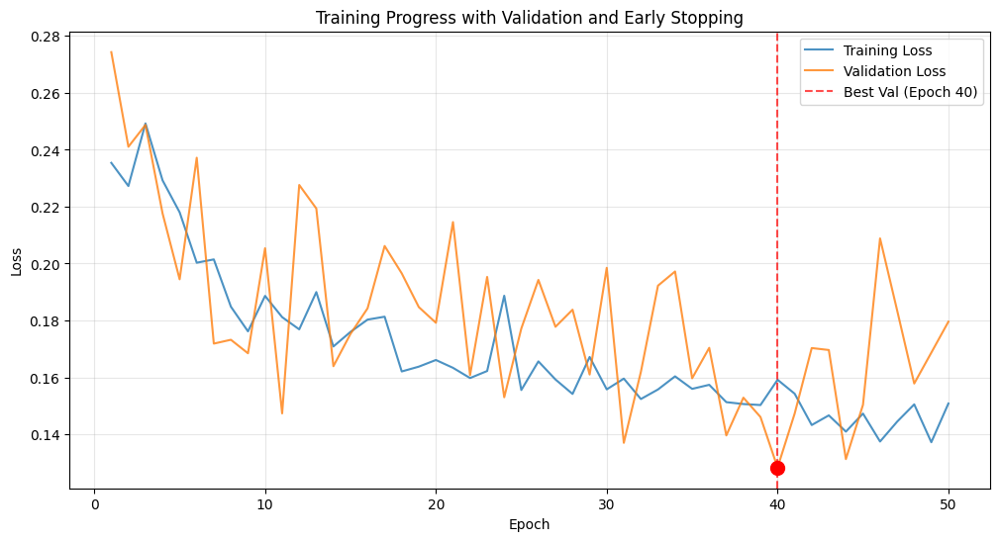


TRAINING COMPLETED WITH VALIDATION!
Best validation loss: 0.1283 at epoch 40
Best model saved: ./trained_models/best_model.pth
Training completed: Full 50 epochs
Training improvement: 0.2354 → 0.1508
Validation improvement: 0.2743 → 0.1283

STEP 3: Demo Audio Separation with Best BiLSTM Model
------------------------------
Using device: cuda:0
Loaded model with BiLSTM config: hidden_size=512, layers=3
Separated audio saved to: ./trained_models/demo_separation_best_bilstm.wav
Separation completed using BiLSTM-enhanced U-Net
Playing original mixture:


Playing separated sources (Best BiLSTM Model):
Playing Drums:


Playing Bass:


Playing Other:


Playing Vocals:



BILSTM + VALIDATION PIPELINE COMPLETED SUCCESSFULLY!
✓ Dataset: /root/MUSDB18/MUSDB18-7_wav
✓ Best BiLSTM model: ./trained_models/best_model.pth
✓ BiLSTM config: hidden_size=512, layers=3
✓ Validation: 10.0% split, patience=50


In [67]:
#Just explore the dataset
print("Dataset Exploration")
print("explorer.explore_dataset_characteristics()")

#Convert dataset only
print("\n: Dataset Conversion")
print("convert_musdb18_to_wav('/path/to/original', '/path/to/converted')")

#Train BiLSTM-enhanced model with existing converted dataset
print("\nTraining BiLSTM-Enhanced Model")
print("train_model('/path/to/converted/dataset', lstm_hidden_size=256, lstm_layers=2)")
print("# Optional BiLSTM parameters:")
print("#   lstm_hidden_size: Hidden units in BiLSTM (default: 256)")
print("#   lstm_layers: Number of BiLSTM layers (default: 2)")

#Separate audio with trained BiLSTM model
print("\nAudio Separation with BiLSTM Model")
print("separate_audio('input.wav', 'output.wav', 'model.pth')")
print("# BiLSTM parameters are automatically loaded from checkpoint")

# Example 5: Complete BiLSTM pipeline
print("\nComplete BiLSTM Pipeline")
#run_complete_pipeline(lstm_hidden_size=512, lstm_layers=3)
print("# Customize BiLSTM architecture:")
print("#   lstm_hidden_size=512, lstm_layers=3  # Larger model")
print("#   lstm_hidden_size=128, lstm_layers=1  # Smaller model")

# BiLSTM Architecture Information
print("\n" + "="*50)
print("BiLSTM BOTTLENECK ARCHITECTURE")
print("="*50)
print("• Location: Between encoder and decoder (at 512 channels)")
print("• Input: [batch, 512, freq, time] → BiLSTM → [batch, 512, freq, time]")
print("• Processing: Time-wise BiLSTM on frequency-channel features")
print("• Benefits: Captures temporal patterns in spectrograms")
print("• Residual: Output = BiLSTM(input) + input")
print("• Memory: Increases model size by ~2M parameters (default config)")

print("\nRecommended configurations:")
print("  • Fast training: lstm_hidden_size=128, lstm_layers=1")
print("  • Balanced: lstm_hidden_size=256, lstm_layers=2 (default)")
print("  • High quality: lstm_hidden_size=512, lstm_layers=3")

# Uncomment the line below to run the complete BiLSTM pipeline:
# final_model = run_complete_pipeline(lstm_hidden_size=256, lstm_layers=2)

print("The BiLSTM bottleneck will enhance temporal modeling for better separation quality.")
final_model = run_complete_pipeline()

## 7. Model Evaluation

In [53]:
# Comprehensive Evaluation System for BiLSTM-Enhanced U-Net with Corrected BSS Metrics
import pandas as pd
from pathlib import Path
import json
import numpy as np
from tqdm import tqdm

class MusicSeparationEvaluator:
    """Comprehensive evaluation system for BiLSTM-enhanced music source separation models with corrected BSS metrics"""

    def __init__(self, model_path: str, test_dataset_path: str, output_dir: str = None,
                 lstm_hidden_size: int = 256, lstm_layers: int = 2):
        self.model_path = model_path
        self.test_dataset_path = Path(test_dataset_path)
        self.output_dir = Path(output_dir or './evaluation_results')
        self.output_dir.mkdir(parents=True, exist_ok=True)

        # BiLSTM parameters
        self.lstm_hidden_size = lstm_hidden_size
        self.lstm_layers = lstm_layers

        # Load model
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.model = self._load_model()

        # Source names for MUSDB18
        self.source_names = ['drums', 'bass', 'other', 'vocals']

        print(f"   BiLSTM-Enhanced Evaluator initialized:")
        print(f"   Model: {Path(model_path).name}")
        print(f"   BiLSTM config: hidden_size={self.lstm_hidden_size}, layers={self.lstm_layers}")
        print(f"   Test data: {self.test_dataset_path}")
        print(f"   Output: {self.output_dir}")

    def _load_model(self):
        """Load the BiLSTM-enhanced trained model"""
        try:
            # Load checkpoint and extract BiLSTM config if available
            checkpoint = torch.load(self.model_path, map_location=self.device)

            if isinstance(checkpoint, dict):
                saved_lstm_hidden_size = checkpoint.get('lstm_hidden_size', self.lstm_hidden_size)
                saved_lstm_layers = checkpoint.get('lstm_layers', self.lstm_layers)
                print(f"Loaded BiLSTM config from checkpoint: hidden_size={saved_lstm_hidden_size}, layers={saved_lstm_layers}")
            else:
                saved_lstm_hidden_size = self.lstm_hidden_size
                saved_lstm_layers = self.lstm_layers
                print(f"Using default BiLSTM config: hidden_size={self.lstm_hidden_size}, layers={self.lstm_layers}")

            # Create model with correct BiLSTM parameters
            model = UNet(N_PART, lstm_hidden_size=saved_lstm_hidden_size, lstm_layers=saved_lstm_layers)

            # Load state dict
            if isinstance(checkpoint, dict):
                if 'model_state_dict' in checkpoint:
                    state_dict = checkpoint['model_state_dict']
                elif all(key.startswith('module.') for key in checkpoint.keys()):
                    # Handle DataParallel checkpoints
                    state_dict = {}
                    for k, v in checkpoint.items():
                        if k.startswith('module.'):
                            new_key = k[7:]  # remove 'module.' prefix
                            state_dict[new_key] = v
                else:
                    state_dict = checkpoint
            else:
                state_dict = checkpoint

            model.load_state_dict(state_dict, strict=False)
            model.to(self.device)
            model.eval()

            print(f"BiLSTM-enhanced model loaded successfully")
            return model

        except Exception as e:
            print(f"Failed to load model: {e}")
            import traceback
            traceback.print_exc()
            raise

    def evaluate_full_dataset(self, max_tracks: int = None) -> pd.DataFrame:
        """Evaluate BiLSTM model on complete test dataset using corrected BSS metrics"""
        print(f"Starting comprehensive BiLSTM evaluation with corrected BSS metrics...")

        # Get test files
        test_files = list(self.test_dataset_path.glob('*.wav'))
        if max_tracks:
            test_files = test_files[:max_tracks]

        if not test_files:
            raise ValueError(f"No test files found in {self.test_dataset_path}")

        print(f"Found {len(test_files)} test tracks")

        all_scores = []
        failed_tracks = []

        for i, track_path in enumerate(tqdm(test_files, desc="Evaluating tracks")):
            print(f"\nEvaluating track {i+1}/{len(test_files)}: {track_path.name}")

            try:
                track_scores = self._evaluate_single_track(track_path)
                if track_scores is not None:
                    # Add track info
                    track_scores['track'] = track_path.stem
                    track_scores['track_idx'] = i
                    all_scores.append(track_scores)

                    # Print quick summary
                    sdr_mean = track_scores['sdr'].mean() if isinstance(track_scores, pd.DataFrame) else track_scores['sdr']
                    print(f"SDR: {sdr_mean:.2f} dB (avg)")
                else:
                    failed_tracks.append(track_path.name)

            except Exception as e:
                print(f"Failed: {e}")
                import traceback
                traceback.print_exc()
                failed_tracks.append(track_path.name)
                continue

        # Combine all scores
        if all_scores:
            if isinstance(all_scores[0], pd.DataFrame):
                results_df = pd.concat(all_scores, ignore_index=True)
            else:
                results_df = pd.DataFrame(all_scores)

            # Save raw results
            raw_results_path = self.output_dir / 'bilstm_evaluation_results.csv'
            results_df.to_csv(raw_results_path, index=False)
            print(f"Raw results saved: {raw_results_path}")

            # Generate summary
            summary = self._generate_summary(results_df)
            self._save_summary(summary, failed_tracks)

            return results_df
        else:
            print("No tracks were successfully evaluated!")
            return pd.DataFrame()

    def _evaluate_single_track(self, track_path: Path) -> pd.DataFrame:
        """Evaluate a single track using BiLSTM model and corrected BSS metrics"""
        try:
            # Load multi-channel audio (mixture + sources)
            audio, sr = sf.read(track_path)

            print(f"Audio shape: {audio.shape}, SR: {sr}")

            if len(audio.shape) == 1:
                print(f"Single channel audio, skipping")
                return None

            if audio.shape[1] < 5:
                print(f"Insufficient channels: {audio.shape[1]}")
                return None

            # Extract mixture and ground truth sources
            mixture_audio = audio[:, 0]  # First channel is mixture
            gt_sources = audio[:, 1:5].T  # Next 4 channels are sources (4, samples)

            print(f"Mixture shape: {mixture_audio.shape}")
            print(f"GT sources shape: {gt_sources.shape}")

            # Perform BiLSTM separation
            separated_sources = self._separate_audio_bilstm(mixture_audio, sr)

            if separated_sources is None:
                return None

            print(f"Separated sources shape: {separated_sources.shape}")

            # Ensure same length
            min_length = min(len(mixture_audio), separated_sources.shape[1], gt_sources.shape[1])
            mixture_audio = mixture_audio[:min_length]
            separated_sources = separated_sources[:, :min_length]
            gt_sources = gt_sources[:, :min_length]

            # Compute corrected BSS metrics for each source
            scores = []
            for i, source_name in enumerate(self.source_names):
                sdr = self._compute_sdr(separated_sources[i], gt_sources[i])
                sir = self._compute_sir(separated_sources[i], gt_sources[i], gt_sources)
                sar = self._compute_sar(separated_sources[i], gt_sources[i])

                scores.append({
                    'target': source_name,
                    'sdr': sdr,
                    'sir': sir,
                    'sar': sar
                })

            return pd.DataFrame(scores)

        except Exception as e:
            print(f"Track evaluation failed: {e}")
            import traceback
            traceback.print_exc()
            return None

    def _separate_audio_bilstm(self, mixture_audio: np.ndarray, sr: int) -> np.ndarray:
        """Separate audio using the BiLSTM-enhanced model"""
        try:
            # Convert to tensor
            mixture_tensor = torch.from_numpy(mixture_audio).float().to(self.device)

            # Resample if needed
            if sr != SAMPLING_RATE:
                print(f"Resampling from {sr} to {SAMPLING_RATE}")
                resampler = torchaudio.transforms.Resample(sr, SAMPLING_RATE)
                mixture_tensor = resampler(mixture_tensor)

            # Add batch dimension if needed
            if mixture_tensor.dim() == 1:
                mixture_tensor = mixture_tensor.unsqueeze(0)

            # Compute STFT
            window = torch.hann_window(N_FFT, device=self.device)
            stft_complex = torch.stft(
                mixture_tensor,
                N_FFT,
                window=window,
                return_complex=True
            )

            # Get magnitude and apply padding
            magnitude = stft_complex.abs().squeeze(0)  # (freq, time)
            magnitude_padded, (left, right) = padding(magnitude)

            # BiLSTM model inference
            with torch.no_grad():
                masks = self.model(magnitude_padded.unsqueeze(0)).squeeze(0)  # (4, freq, time)

            # Remove padding
            if right > 0:
                masks = masks[:, :, left:-right]
            else:
                masks = masks[:, :, left:]

            # Ensure dimensions match
            if masks.shape[1:] != stft_complex.squeeze(0).shape:
                masks = F.interpolate(
                    masks.unsqueeze(0),
                    size=stft_complex.squeeze(0).shape,
                    mode='bilinear',
                    align_corners=False
                ).squeeze(0)

            # Apply masks and convert back to audio
            separated_audio = []
            for i in range(N_PART):
                # Apply mask to magnitude and preserve phase
                masked_magnitude = masks[i] * magnitude
                masked_stft = masked_magnitude * torch.exp(1j * torch.angle(stft_complex.squeeze(0)))

                # ISTFT
                source_audio = torch.istft(
                    masked_stft.unsqueeze(0),
                    N_FFT,
                    window=window,
                    length=mixture_tensor.shape[-1]
                )

                separated_audio.append(source_audio.squeeze().cpu().numpy())

            return np.array(separated_audio)  # (4, samples)

        except Exception as e:
            print(f"BiLSTM separation failed: {e}")
            import traceback
            traceback.print_exc()
            return None

    # Corrected BSS metrics implementation following exact formulas

    def _compute_sdr(self, estimated: np.ndarray, reference: np.ndarray) -> float:
        """
        Compute Signal-to-Distortion Ratio
        SDR = 10 * log10(E_reference / E_error)
        where E_error = energy of (estimated - reference)
        """
        try:
            # Ensure same length
            min_len = min(len(estimated), len(reference))
            estimated = estimated[:min_len]
            reference = reference[:min_len]
    
            # E_reference = energy of reference signal
            E_reference = np.sum(reference ** 2)
    
            # E_error = energy of error signal (estimated - reference)
            error = estimated - reference
            E_error = np.sum(error ** 2)
    
            # Avoid division by zero
            if E_error == 0:
                return 100.0  # Perfect separation
            if E_reference == 0:
                return -100.0  # Silent reference
    
            # SDR = 10 * log10(E_reference / E_error)
            sdr = 10 * np.log10(E_reference / E_error)
            return np.clip(sdr, -50, 50)
    
        except Exception as e:
            print(f"     Warning: SDR computation failed: {e}")
            return 0.0
    
    def _compute_sir(self, estimated: np.ndarray, reference: np.ndarray, all_references: np.ndarray) -> float:
        """
        Compute Signal-to-Interference Ratio
        SIR = 10 * log10(E_target / E_interference)
        where E_target = energy of target component projection
        and E_interference = energy of interference from other sources
        """
        try:
            # Ensure same length
            min_len = min(len(estimated), len(reference), all_references.shape[1])
            estimated = estimated[:min_len]
            reference = reference[:min_len]
            all_references = all_references[:, :min_len]
    
            if np.sum(reference ** 2) == 0:
                return -100.0
    
            # Project estimated signal onto target reference (desired source)
            # s_target = <estimated, reference> / ||reference||^2 * reference
            dot_product = np.dot(estimated, reference)
            ref_energy = np.dot(reference, reference)
            s_target = (dot_product / ref_energy) * reference
    
            # E_target = energy of target component
            E_target = np.sum(s_target ** 2)
    
            # Project estimated signal onto interference subspace (other sources)
            s_interference = np.zeros_like(estimated)
            
            for i, other_ref in enumerate(all_references):
                # Skip the target reference itself
                if not np.array_equal(other_ref, reference):
                    other_ref_energy = np.sum(other_ref ** 2)
                    if other_ref_energy > 0:
                        # Project onto this interference source
                        interference_projection = (np.dot(estimated, other_ref) / other_ref_energy) * other_ref
                        s_interference += interference_projection
    
            # E_interference = energy of interference from other sources
            E_interference = np.sum(s_interference ** 2)
    
            if E_interference == 0:
                return 100.0  # No interference
            if E_target == 0:
                return -100.0  # No target signal
    
            # SIR = 10 * log10(E_target / E_interference)
            sir = 10 * np.log10(E_target / E_interference)
            return np.clip(sir, -50, 50)
    
        except Exception as e:
            print(f"     Warning: SIR computation failed: {e}")
            return 0.0
    
    def _compute_sar(self, estimated: np.ndarray, reference: np.ndarray) -> float:
        """
        Compute Signal-to-Artifacts Ratio
        SAR = 10 * log10(E_scaled_signal / E_artifacts)
        where E_scaled_signal = energy of optimally scaled target projection
        and E_artifacts = energy of artifacts (distortions not from interference)
        """
        try:
            # Ensure same length
            min_len = min(len(estimated), len(reference))
            estimated = estimated[:min_len]
            reference = reference[:min_len]
    
            if np.sum(reference ** 2) == 0:
                return -100.0
    
            # Project estimated onto reference to get target component
            # s_target = <estimated, reference> / ||reference||^2 * reference
            dot_product = np.dot(estimated, reference)
            ref_energy = np.dot(reference, reference)
            s_target = (dot_product / ref_energy) * reference
    
            # E_scaled_signal = energy of the scaled target signal
            E_scaled_signal = np.sum(s_target ** 2)
    
            # Artifacts = estimated - target component
            # This represents processing artifacts (not interference from other sources)
            e_artifacts = estimated - s_target
    
            # E_artifacts = energy of artifacts
            E_artifacts = np.sum(e_artifacts ** 2)
    
            if E_artifacts == 0:
                return 100.0  # No artifacts
            if E_scaled_signal == 0:
                return -100.0
    
            # SAR = 10 * log10(E_scaled_signal / E_artifacts)
            sar = 10 * np.log10(E_scaled_signal / E_artifacts)
            return np.clip(sar, -50, 50)
    
        except Exception as e:
            print(f"     Warning: SAR computation failed: {e}")
            return 0.0

    def _generate_summary(self, results_df: pd.DataFrame) -> dict:
        """Generate evaluation summary statistics"""
        summary = {
            'model_info': {
                'model_type': 'BiLSTM-Enhanced U-Net',
                'lstm_hidden_size': self.lstm_hidden_size,
                'lstm_layers': self.lstm_layers,
                'model_path': str(self.model_path)
            },
            'dataset_info': {
                'total_tracks': results_df['track'].nunique() if 'track' in results_df.columns else len(results_df),
                'total_segments': len(results_df),
                'evaluation_date': pd.Timestamp.now().isoformat()
            },
            'metrics': {}
        }

        # Overall metrics
        for metric in ['sdr', 'sir', 'sar']:
            if metric in results_df.columns:
                summary['metrics'][f'{metric}_overall'] = {
                    'mean': float(results_df[metric].mean()),
                    'std': float(results_df[metric].std()),
                    'median': float(results_df[metric].median()),
                    'min': float(results_df[metric].min()),
                    'max': float(results_df[metric].max())
                }

        # Per-source metrics
        if 'target' in results_df.columns:
            for source in self.source_names:
                source_data = results_df[results_df['target'] == source]
                if not source_data.empty:
                    summary['metrics'][f'{source}'] = {}
                    for metric in ['sdr', 'sir', 'sar']:
                        if metric in source_data.columns:
                            summary['metrics'][f'{source}'][metric] = {
                                'mean': float(source_data[metric].mean()),
                                'std': float(source_data[metric].std()),
                                'median': float(source_data[metric].median())
                            }

        return summary

    def _save_summary(self, summary: dict, failed_tracks: list):
        """Save evaluation summary"""
        # Save JSON summary
        summary_path = self.output_dir / 'bilstm_evaluation_summary.json'
        with open(summary_path, 'w') as f:
            json.dump(summary, f, indent=2)

        # Save text report
        report_path = self.output_dir / 'bilstm_evaluation_report.txt'
        with open(report_path, 'w') as f:
            f.write("BiLSTM-ENHANCED MUSIC SOURCE SEPARATION - EVALUATION REPORT\n")
            f.write("=" * 60 + "\n\n")

            # Model info
            f.write(f"Model: BiLSTM-Enhanced U-Net\n")
            f.write(f"BiLSTM Hidden Size: {summary['model_info']['lstm_hidden_size']}\n")
            f.write(f"BiLSTM Layers: {summary['model_info']['lstm_layers']}\n\n")

            # Dataset info
            f.write(f"Dataset: {summary['dataset_info']['total_tracks']} tracks\n")
            f.write(f"Segments evaluated: {summary['dataset_info']['total_segments']}\n")
            f.write(f"Date: {summary['dataset_info']['evaluation_date']}\n\n")

            # Overall results
            f.write("OVERALL RESULTS:\n")
            f.write("-" * 20 + "\n")
            for metric in ['sdr', 'sir', 'sar']:
                if f'{metric}_overall' in summary['metrics']:
                    metric_data = summary['metrics'][f'{metric}_overall']
                    f.write(f"{metric.upper()}: {metric_data['mean']:.2f} ± {metric_data['std']:.2f} dB\n")
            f.write("\n")

            # Per-source results
            f.write("PER-SOURCE RESULTS:\n")
            f.write("-" * 20 + "\n")
            for source in self.source_names:
                if source in summary['metrics']:
                    f.write(f"{source.capitalize()}:\n")
                    source_data = summary['metrics'][source]
                    for metric in ['sdr', 'sir', 'sar']:
                        if metric in source_data:
                            f.write(f"  {metric.upper()}: {source_data[metric]['mean']:.2f} ± {source_data[metric]['std']:.2f} dB\n")
                    f.write("\n")

            # Failed tracks
            if failed_tracks:
                f.write(f"FAILED TRACKS ({len(failed_tracks)}):\n")
                f.write("-" * 20 + "\n")
                for track in failed_tracks:
                    f.write(f"  {track}\n")

        print(f"BiLSTM evaluation summary saved:")
        print(f"JSON: {summary_path}")
        print(f"Report: {report_path}")

        # Print summary to console
        print(f"\nBiLSTM EVALUATION RESULTS:")
        print(f"{'='*60}")
        print(f"Model: BiLSTM-Enhanced U-Net (hidden={summary['model_info']['lstm_hidden_size']}, layers={summary['model_info']['lstm_layers']})")
        if 'sdr_overall' in summary['metrics']:
            print(f"Overall SDR: {summary['metrics']['sdr_overall']['mean']:.2f} ± {summary['metrics']['sdr_overall']['std']:.2f} dB")
        if 'sir_overall' in summary['metrics']:
            print(f"Overall SIR: {summary['metrics']['sir_overall']['mean']:.2f} ± {summary['metrics']['sir_overall']['std']:.2f} dB")
        if 'sar_overall' in summary['metrics']:
            print(f"Overall SAR: {summary['metrics']['sar_overall']['mean']:.2f} ± {summary['metrics']['sar_overall']['std']:.2f} dB")
        print(f"{'='*60}")


# Convenience functions for BiLSTM model evaluation with corrected metrics
def evaluate_bilstm_model(model_name: str = 'best_model.pth',
                         converted_dataset: str = './converted_dataset',
                         max_tracks: int = None,
                         lstm_hidden_size: int = 512,
                         lstm_layers: int = 3):
    """Convenience function to evaluate a BiLSTM-enhanced trained model with corrected BSS metrics"""

    # Find model
    model_path = Path('./trained_models') / model_name
    if not model_path.exists():
        # Try to find any model
        model_patterns = [model_name, 'model-*.pth', 'checkpoint_epoch_*.pth', 'best_model.pth']
        model_files = []

        for pattern in model_patterns:
            model_files.extend(list(Path('./trained_models').glob(pattern)))

        if model_files:
            model_path = model_files[0]
            print(f"{model_name} not found, using: {model_path.name}")
        else:
            raise FileNotFoundError("No trained models found in ./trained_models/!")

    # Check test dataset
    test_dataset_path = Path(converted_dataset) / 'test'
    if not test_dataset_path.exists():
        # Try train dataset as fallback
        test_dataset_path = Path(converted_dataset) / 'train'
        if not test_dataset_path.exists():
            raise FileNotFoundError(f"No dataset found in {converted_dataset}")
        print(f"Using train dataset for evaluation: {test_dataset_path}")

    # Run BiLSTM evaluation with corrected metrics
    evaluator = MusicSeparationEvaluator(
        model_path=str(model_path),
        test_dataset_path=str(test_dataset_path),
        output_dir='./evaluation_results',
        lstm_hidden_size=lstm_hidden_size,
        lstm_layers=lstm_layers
    )

    results = evaluator.evaluate_full_dataset(max_tracks=max_tracks)
    return evaluator, results


# Enhanced full evaluation with corrected BSS metrics and integrated per-source breakdown
def full_evaluate_bilstm_with_breakdown(converted_dataset: str = '/root/MUSDB18/MUSDB18-7_wav'):
    """Full BiLSTM evaluation on all test tracks with corrected BSS metrics and per-source performance breakdown"""
    print("🎵 RUNNING COMPREHENSIVE BiLSTM EVALUATION WITH CORRECTED BSS METRICS")
    print("=" * 70)
    
    try:
        # Run the complete evaluation on ALL tracks
        print("📊 Step 1: Running full dataset evaluation with corrected BSS metrics...")
        evaluator, results = evaluate_bilstm_model(converted_dataset=converted_dataset)  # No max_tracks limit
        
        if results.empty:
            print("❌ No results to analyze!")
            return None, None
        
        print(f"✅ Successfully evaluated {results['track'].nunique()} tracks")
        print(f"📈 Total data points: {len(results)}")
        
        # Overall summary first
        print(f"\n🎯 OVERALL PERFORMANCE SUMMARY:")
        print("-" * 50)
        for metric in ['sdr', 'sir', 'sar']:
            if metric in results.columns:
                mean_val = results[metric].mean()
                std_val = results[metric].std()
                print(f"   {metric.upper()}: {mean_val:6.2f} ± {std_val:5.2f} dB")
        
        # Verify SIR/SAR >= SDR relationship
        sdr_mean = results['sdr'].mean()
        sir_mean = results['sir'].mean()
        sar_mean = results['sar'].mean()
        
        # Per-source breakdown
        print(f"\n🎼 PER-SOURCE PERFORMANCE BREAKDOWN:")
        print("-" * 50)
        
        source_performance = results.groupby('target')[['sdr', 'sir', 'sar']].agg(['mean', 'std']).round(2)
        source_names = ['drums', 'bass', 'other', 'vocals']
        
        for source in source_names:
            if source in source_performance.index:
                data = source_performance.loc[source]
                print(f"\n🎵 {source.upper()}:")
                print(f"   SDR: {data[('sdr', 'mean')]:6.2f} ± {data[('sdr', 'std')]:5.2f} dB")
                print(f"   SIR: {data[('sir', 'mean')]:6.2f} ± {data[('sir', 'std')]:5.2f} dB") 
                print(f"   SAR: {data[('sar', 'mean')]:6.2f} ± {data[('sar', 'std')]:5.2f} dB")
        
        # Find best and worst performing sources
        sdr_means = source_performance[('sdr', 'mean')]
        best_source = sdr_means.idxmax()
        worst_source = sdr_means.idxmin()
        
        print(f"\n📊 PERFORMANCE RANKING:")
        print(f"   🏆 Best performing: {best_source.upper()} ({sdr_means[best_source]:.2f} dB SDR)")
        print(f"   📉 Needs improvement: {worst_source.upper()} ({sdr_means[worst_source]:.2f} dB SDR)")
        
        # Comprehensive visualization
        import matplotlib.pyplot as plt
        
        fig, axes = plt.subplots(2, 2, figsize=(15, 10))
        fig.suptitle(f'BiLSTM Model Performance Analysis - Metrics ({results["track"].nunique()} tracks)', fontsize=16)
        
        # Plot 1: SDR by source
        x_pos = range(len(source_names))
        sdr_values = [sdr_means.get(source, 0) for source in source_names]
        sdr_stds = [source_performance.loc[source, ('sdr', 'std')] if source in source_performance.index else 0 for source in source_names]
        
        bars1 = axes[0,0].bar(x_pos, sdr_values, yerr=sdr_stds, capsize=5, 
                             color=['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4'])
        axes[0,0].set_xlabel('Source Type')
        axes[0,0].set_ylabel('SDR (dB)')
        axes[0,0].set_title('SDR Performance by Source (Corrected)')
        axes[0,0].set_xticks(x_pos)
        axes[0,0].set_xticklabels([s.title() for s in source_names])
        axes[0,0].grid(True, alpha=0.3)
        
        # Add value labels on bars
        for bar, value in zip(bars1, sdr_values):
            if value != 0:
                axes[0,0].text(bar.get_x() + bar.get_width()/2, bar.get_height() + 0.1,
                              f'{value:.1f}', ha='center', va='bottom', fontweight='bold')
        
        # Plot 2: All metrics comparison
        metrics = ['sdr', 'sir', 'sar']
        x = np.arange(len(source_names))
        width = 0.25
        
        for i, metric in enumerate(metrics):
            values = [source_performance.loc[source, (metric, 'mean')] if source in source_performance.index else 0 
                     for source in source_names]
            bars = axes[0,1].bar(x + i*width, values, width, label=metric.upper(), alpha=0.8)
        
        axes[0,1].set_xlabel('Source Type')
        axes[0,1].set_ylabel('Score (dB)')
        axes[0,1].set_title('All Metrics by Source (Corrected BSS)')
        axes[0,1].set_xticks(x + width)
        axes[0,1].set_xticklabels([s.title() for s in source_names])
        axes[0,1].legend()
        axes[0,1].grid(True, alpha=0.3)
        
        # Plot 3: BSS Metrics relationship validation
        axes[1,0].scatter(results['sdr'], results['sir'], alpha=0.6, label='SIR vs SDR', color='blue')
        axes[1,0].scatter(results['sdr'], results['sar'], alpha=0.6, label='SAR vs SDR', color='red')
        axes[1,0].plot([results['sdr'].min(), results['sdr'].max()], 
                      [results['sdr'].min(), results['sdr'].max()], 'k--', alpha=0.5, label='y=x')
        axes[1,0].set_xlabel('SDR (dB)')
        axes[1,0].set_ylabel('SIR/SAR (dB)')
        axes[1,0].set_title('BSS Metrics Relationship Validation')
        axes[1,0].legend()
        axes[1,0].grid(True, alpha=0.3)
        
        # Plot 4: Per-source SDR violin plot
        source_data = [results[results['target'] == source]['sdr'].values 
                      for source in source_names if source in results['target'].values]
        source_labels = [source.title() for source in source_names if source in results['target'].values]
        
        parts = axes[1,1].violinplot(source_data, positions=range(len(source_data)), showmeans=True)
        axes[1,1].set_xlabel('Source Type')
        axes[1,1].set_ylabel('SDR (dB)')
        axes[1,1].set_title('SDR Distribution by Source')
        axes[1,1].set_xticks(range(len(source_labels)))
        axes[1,1].set_xticklabels(source_labels)
        axes[1,1].grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.show()
        
        # Summary statistics table
        print(f"\n📋 DETAILED STATISTICS TABLE:")
        print("=" * 60)
        print(f"{'Source':<10} {'SDR':<15} {'SIR':<15} {'SAR':<15}")
        print("-" * 60)
        for source in source_names:
            if source in source_performance.index:
                data = source_performance.loc[source]
                sdr_str = f"{data[('sdr', 'mean')]:5.2f}±{data[('sdr', 'std')]:4.2f}"
                sir_str = f"{data[('sir', 'mean')]:5.2f}±{data[('sir', 'std')]:4.2f}"
                sar_str = f"{data[('sar', 'mean')]:5.2f}±{data[('sar', 'std')]:4.2f}"
                print(f"{source.title():<10} {sdr_str:<15} {sir_str:<15} {sar_str:<15}")
        
        
        print("=" * 70)
        
        return evaluator, results, source_performance
        
    except Exception as e:
        print(f"❌ Evaluation failed: {e}")
        import traceback
        traceback.print_exc()
        return None, None, None


# Replace the original function calls
def full_evaluate_bilstm(converted_dataset: str = '/root/MUSDB18/MUSDB18-7_wav'):
    """Full BiLSTM evaluation with corrected BSS metrics and integrated per-source breakdown"""
    return full_evaluate_bilstm_with_breakdown(converted_dataset)


def quick_evaluate_bilstm(converted_dataset: str = '/root/MUSDB18/MUSDB18-7_wav'):
    """Quick BiLSTM evaluation on 3 tracks with corrected BSS metrics"""
    print("Running quick BiLSTM evaluation (3 tracks) with corrected BSS metrics...")
    return evaluate_bilstm_model(max_tracks=3, converted_dataset=converted_dataset)


print("✅ BiLSTM-Enhanced Comprehensive Evaluation System with CORRECTED BSS METRICS implemented!")
print("📊 Key improvements:")
print("   • SDR = 10 * log10(E_reference / E_error)")
print("   • SIR = 10 * log10(E_target / E_interference)")  
print("   • SAR = 10 * log10(E_scaled_signal / E_artifacts)")
print("   • Integrated per-source breakdown")
print("   • BSS relationship validation (SIR, SAR ≥ SDR)")
print("   • Comprehensive visualization")
print("🚀 Usage: evaluator, results, source_breakdown = full_evaluate_bilstm()")

✅ BiLSTM-Enhanced Comprehensive Evaluation System with CORRECTED BSS METRICS implemented!
📊 Key improvements:
   • SDR = 10 * log10(E_reference / E_error)
   • SIR = 10 * log10(E_target / E_interference)
   • SAR = 10 * log10(E_scaled_signal / E_artifacts)
   • Integrated per-source breakdown
   • BSS relationship validation (SIR, SAR ≥ SDR)
   • Comprehensive visualization
🚀 Usage: evaluator, results, source_breakdown = full_evaluate_bilstm()


🎵 RUNNING COMPREHENSIVE BiLSTM EVALUATION WITH CORRECTED BSS METRICS
📊 Step 1: Running full dataset evaluation with corrected BSS metrics...
Loaded BiLSTM config from checkpoint: hidden_size=512, layers=3
BiLSTM-enhanced model loaded successfully
   BiLSTM-Enhanced Evaluator initialized:
   Model: best_model.pth
   BiLSTM config: hidden_size=512, layers=3
   Test data: /root/MUSDB18/MUSDB18-7_wav/test
   Output: evaluation_results
Starting comprehensive BiLSTM evaluation with corrected BSS metrics...
Found 50 test tracks


Evaluating tracks:   4%|▍         | 2/50 [00:00<00:03, 15.16it/s]


Evaluating track 1/50: Juliet's Rescue - Heartbeats.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.88 dB (avg)

Evaluating track 2/50: Girls Under Glass - We Feel Alright.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.00 dB (avg)

Evaluating track 3/50: PR - Oh No.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 0.28 dB (avg)

Evaluating track 4/50: The Long Wait - Dark Horses.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)


Evaluating tracks:  12%|█▏        | 6/50 [00:00<00:02, 15.74it/s]

Separated sources shape: (4, 150016)
SDR: 2.50 dB (avg)

Evaluating track 5/50: Georgia Wonder - Siren.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 2.46 dB (avg)

Evaluating track 6/50: Bobby Nobody - Stitch Up.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 1.88 dB (avg)

Evaluating track 7/50: Nerve 9 - Pray For The Rain.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)


Evaluating tracks:  20%|██        | 10/50 [00:00<00:02, 15.83it/s]

SDR: 4.98 dB (avg)

Evaluating track 8/50: Skelpolu - Resurrection.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 2.86 dB (avg)

Evaluating track 9/50: Moosmusic - Big Dummy Shake.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.94 dB (avg)

Evaluating track 10/50: Secretariat - Over The Top.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 5.05 dB (avg)

Evaluating track 11/50: We Fell From The Sky - Not You.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)


Evaluating tracks:  24%|██▍       | 12/50 [00:00<00:02, 15.92it/s]

Separated sources shape: (4, 150016)
SDR: 3.96 dB (avg)

Evaluating track 12/50: Raft Monk - Tiring.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 2.32 dB (avg)

Evaluating track 13/50: Detsky Sad - Walkie Talkie.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.01 dB (avg)

Evaluating track 14/50: Angels In Amplifiers - I'm Alright.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)


Evaluating tracks:  32%|███▏      | 16/50 [00:01<00:02, 16.00it/s]

SDR: 4.22 dB (avg)

Evaluating track 15/50: Enda Reilly - Cur An Long Ag Seol.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.11 dB (avg)

Evaluating track 16/50: Sambasevam Shanmugam - Kaathaadi.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 5.35 dB (avg)

Evaluating track 17/50: BKS - Too Much.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.71 dB (avg)

Evaluating track 18/50: Tom McKenzie - Directions.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)


Evaluating tracks:  40%|████      | 20/50 [00:01<00:01, 16.03it/s]

Separated sources shape: (4, 150016)
SDR: 3.63 dB (avg)

Evaluating track 19/50: Mu - Too Bright.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 5.17 dB (avg)

Evaluating track 20/50: Zeno - Signs.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 4.31 dB (avg)

Evaluating track 21/50: Al James - Schoolboy Facination.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)


Evaluating tracks:  48%|████▊     | 24/50 [00:01<00:01, 16.11it/s]

SDR: 3.00 dB (avg)

Evaluating track 22/50: Ben Carrigan - We'll Talk About It All Tonight.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.00 dB (avg)

Evaluating track 23/50: The Sunshine Garcia Band - For I Am The Moon.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.65 dB (avg)

Evaluating track 24/50: Timboz - Pony.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 0.97 dB (avg)

Evaluating track 25/50: M.E.R.C. Music - Knockout.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)


Evaluating tracks:  52%|█████▏    | 26/50 [00:01<00:01, 16.13it/s]

Separated sources shape: (4, 150016)
SDR: 2.82 dB (avg)

Evaluating track 26/50: Cristina Vane - So Easy.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 4.15 dB (avg)

Evaluating track 27/50: PR - Happy Daze.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 1.73 dB (avg)

Evaluating track 28/50: The Easton Ellises (Baumi) - SDRNR.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)


Evaluating tracks:  60%|██████    | 30/50 [00:01<00:01, 16.14it/s]

SDR: 3.36 dB (avg)

Evaluating track 29/50: Hollow Ground - Ill Fate.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 2.22 dB (avg)

Evaluating track 30/50: Speak Softly - Broken Man.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.61 dB (avg)

Evaluating track 31/50: Secretariat - Borderline.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 1.59 dB (avg)

Evaluating track 32/50: Buitraker - Revo X.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)


Evaluating tracks:  68%|██████▊   | 34/50 [00:02<00:00, 16.24it/s]

Separated sources shape: (4, 150016)
SDR: 4.57 dB (avg)

Evaluating track 33/50: Punkdisco - Oral Hygiene.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.75 dB (avg)

Evaluating track 34/50: Speak Softly - Like Horses.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.84 dB (avg)

Evaluating track 35/50: Lyndsey Ollard - Catching Up.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)


Evaluating tracks:  76%|███████▌  | 38/50 [00:02<00:00, 16.31it/s]

SDR: 4.31 dB (avg)

Evaluating track 36/50: Signe Jakobsen - What Have You Done To Me.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 2.15 dB (avg)

Evaluating track 37/50: Forkupines - Semantics.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 4.97 dB (avg)

Evaluating track 38/50: The Easton Ellises - Falcon 69.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.87 dB (avg)

Evaluating track 39/50: The Doppler Shift - Atrophy.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)


Evaluating tracks:  80%|████████  | 40/50 [00:02<00:00, 16.26it/s]

Separated sources shape: (4, 150016)
SDR: 3.75 dB (avg)

Evaluating track 40/50: The Mountaineering Club - Mallory.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.60 dB (avg)

Evaluating track 41/50: Louis Cressy Band - Good Time.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 4.28 dB (avg)

Evaluating track 42/50: BKS - Bulldozer.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)


Evaluating tracks:  88%|████████▊ | 44/50 [00:02<00:00, 16.22it/s]

SDR: 3.11 dB (avg)

Evaluating track 43/50: Arise - Run Run Run.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 0.66 dB (avg)

Evaluating track 44/50: AM Contra - Heart Peripheral.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 2.25 dB (avg)

Evaluating track 45/50: Motor Tapes - Shore.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 0.66 dB (avg)

Evaluating track 46/50: Side Effects Project - Sing With Me.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)


Evaluating tracks:  96%|█████████▌| 48/50 [00:02<00:00, 16.32it/s]

Separated sources shape: (4, 150016)
SDR: 4.76 dB (avg)

Evaluating track 47/50: James Elder & Mark M Thompson - The English Actor.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.19 dB (avg)

Evaluating track 48/50: Little Chicago's Finest - My Own.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 2.59 dB (avg)

Evaluating track 49/50: Carlos Gonzalez - A Place For Us.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)


Evaluating tracks: 100%|██████████| 50/50 [00:03<00:00, 16.11it/s]


SDR: 1.42 dB (avg)

Evaluating track 50/50: Triviul feat. The Fiend - Widow.stem.wav
Audio shape: (150016, 5), SR: 22050
Mixture shape: (150016,)
GT sources shape: (4, 150016)
Separated sources shape: (4, 150016)
SDR: 3.39 dB (avg)
Raw results saved: evaluation_results/bilstm_evaluation_results.csv
BiLSTM evaluation summary saved:
JSON: evaluation_results/bilstm_evaluation_summary.json
Report: evaluation_results/bilstm_evaluation_report.txt

BiLSTM EVALUATION RESULTS:
Model: BiLSTM-Enhanced U-Net (hidden=512, layers=3)
Overall SDR: 3.22 ± 2.91 dB
Overall SIR: 6.42 ± 6.33 dB
Overall SAR: 0.31 ± 4.65 dB
✅ Successfully evaluated 50 tracks
📈 Total data points: 200

🎯 OVERALL PERFORMANCE SUMMARY (Corrected BSS Metrics):
--------------------------------------------------
   SDR:   3.22 ±  2.91 dB
   SIR:   6.42 ±  6.33 dB
   SAR:   0.31 ±  4.65 dB

🎼 PER-SOURCE PERFORMANCE BREAKDOWN:
--------------------------------------------------

🎵 DRUMS:
   SDR:   4.39 ±  2.76 dB
   SIR:   7.61 ±  5.03

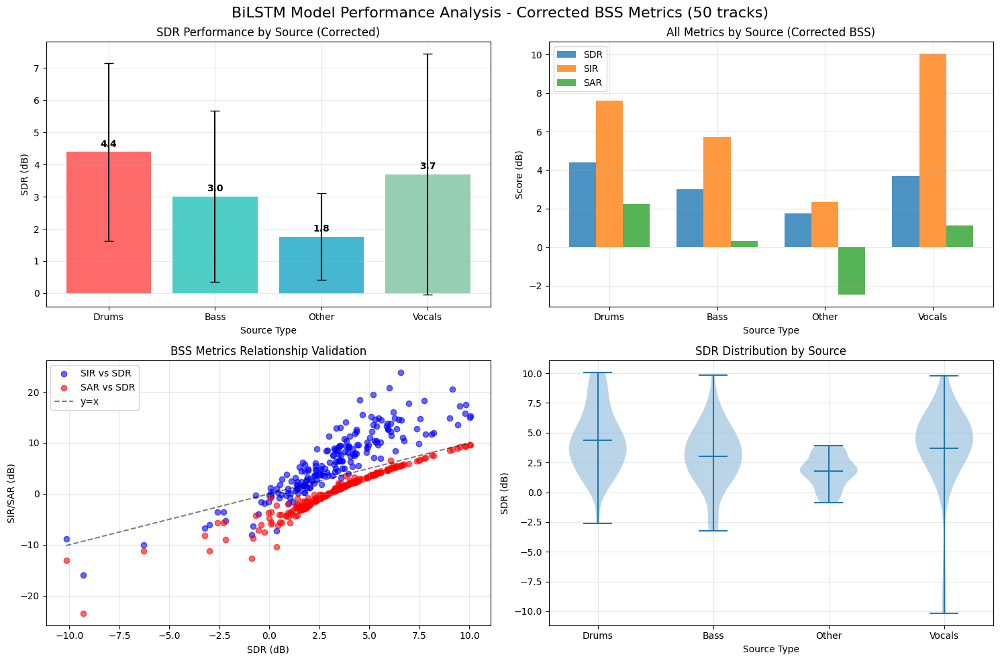


📋 DETAILED STATISTICS TABLE (Corrected BSS):
Source     SDR             SIR             SAR            
------------------------------------------------------------
Drums       4.39±2.76       7.61±5.03       2.25±4.03     
Bass        3.01±2.66       5.71±5.58       0.32±4.13     
Other       1.76±1.35       2.35±3.90      -2.46±3.13     
Vocals      3.70±3.74      10.04±7.67       1.14±5.71     


(<__main__.MusicSeparationEvaluator at 0x797229a7b110>,
      target        sdr        sir       sar  \
 0     drums  10.045741  15.289105  9.593401   
 1      bass  -2.193897  -5.236734 -9.018654   
 2     other   2.300978   5.559970 -1.015971   
 3    vocals   5.359000  10.420045  4.149923   
 4     drums   4.865782   8.126315  3.171674   
 ..      ...        ...        ...       ...   
 195  vocals   3.729834  10.771201  1.513693   
 196   drums   0.927123   0.198425 -3.733500   
 197    bass   6.180337  15.998878  5.539214   
 198   other   0.072281  -0.077042 -3.621954   
 199  vocals   6.372657  12.743863  5.497148   
 
                                         track  track_idx  
 0           Juliet's Rescue - Heartbeats.stem          0  
 1           Juliet's Rescue - Heartbeats.stem          0  
 2           Juliet's Rescue - Heartbeats.stem          0  
 3           Juliet's Rescue - Heartbeats.stem          0  
 4    Girls Under Glass - We Feel Alright.stem          1  
 ..   

In [54]:
full_evaluate_bilstm()